# 0. Wczytanie odpowiednich bibliotek

Instalacja odpowiednich bibliotek

In [2]:
pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
pip install mapclassify

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
pip install contextily

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 50.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 kB 6.7 MB/s eta 0:00:00


Wczytanie odpowiednich bibliotek

In [5]:
import pandas as pd
import numpy as np
import geopandas
import random
import time
import folium
import mapclassify
import contextily
import matplotlib.pyplot as plt
from shapely.geometry import MultiPoint, LineString, Point
from shapely.plotting import plot_polygon
from shapely.affinity import translate, scale
from geopy.distance import distance


# 1. Analiza zbiorów danych

* Zbiór danych „Mapa Świata”

In [6]:
# Mapa świat
countries = geopandas.read_file("ne_110m_admin_0_countries.zip")

In [7]:
# Przykładowe dane
countries.head()

,iso_a3,name,continent,pop_est,gdp_md_est,geometry
0,AFG,Afghanistan,Asia,34124811.0,64080.0,"POLYGON ((61.21082 35.65007, 62.23065 35.27066..."
1,AGO,Angola,Africa,29310273.0,189000.0,"MULTIPOLYGON (((23.90415 -11.72228, 24.07991 -..."
2,ALB,Albania,Europe,3047987.0,33900.0,"POLYGON ((21.02004 40.84273, 20.99999 40.58000..."
3,ARE,United Arab Emirates,Asia,6072475.0,667200.0,"POLYGON ((51.57952 24.24550, 51.75744 24.29407..."
4,ARG,Argentina,South America,44293293.0,879400.0,"MULTIPOLYGON (((-66.95992 -54.89681, -67.56244..."


In [8]:
# Rozmiar zbioru 
countries.shape

(177, 6)

In [9]:
# CRS (ang. Coordinate Reference System)
countries.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Text(0.5, 1.0, 'Mapa świata')

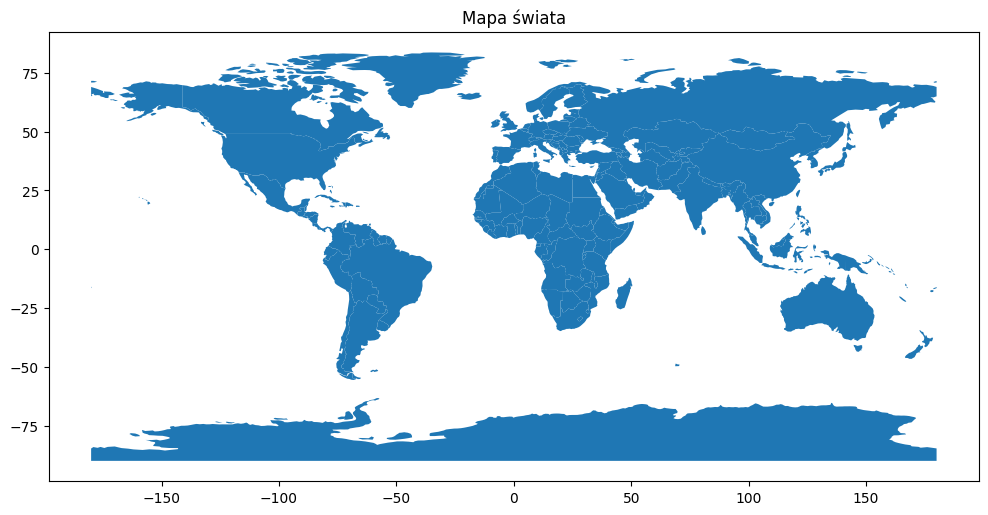

In [10]:
# Wizualizacja
countries.plot(figsize=(12,6))
plt.title("Mapa świata")

In [11]:
countries.explore()

* Zbiór danych „Miasta Świata”

In [12]:
cities = geopandas.read_file("ne_110m_populated_places.zip")

In [13]:
cities.head()

,name,geometry
0,Vatican City,POINT (12.45339 41.90328)
1,San Marino,POINT (12.44177 43.93610)
2,Vaduz,POINT (9.51667 47.13372)
3,Lobamba,POINT (31.20000 -26.46667)
4,Luxembourg,POINT (6.13000 49.61166)


In [14]:
cities.shape

(243, 2)

In [15]:
cities.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Text(0.5, 1.0, 'Miasta świata')

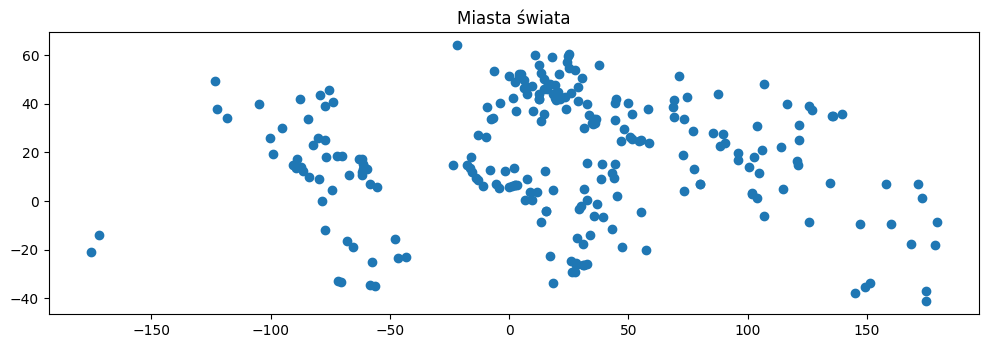

In [16]:
cities.plot(figsize=(12,6))
plt.title("Miasta świata")

* Zbiór danych „Rzeki i jeziora na świecie”

In [18]:
rivers = geopandas.read_file("ne_50m_rivers_lake_centerlines.zip")

In [19]:
rivers.head()

,featurecla,name,geometry
0,Lake Centerline,Kama,"LINESTRING (51.93713 55.70107, 51.88087 55.686..."
1,River,Kama,"LINESTRING (53.69385 58.20632, 53.67715 58.273..."
2,Lake Centerline,Abay,"LINESTRING (37.11301 11.85499, 37.15037 11.893..."
3,Lake Centerline,Al Furat,"LINESTRING (38.56119 35.86264, 38.36534 35.903..."
4,Lake Centerline,Alabama,"MULTILINESTRING ((-86.52177 33.03212, -86.5209..."


In [20]:
rivers.shape

(461, 3)

In [21]:
rivers.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Text(0.5, 1.0, 'Rzeki świata')

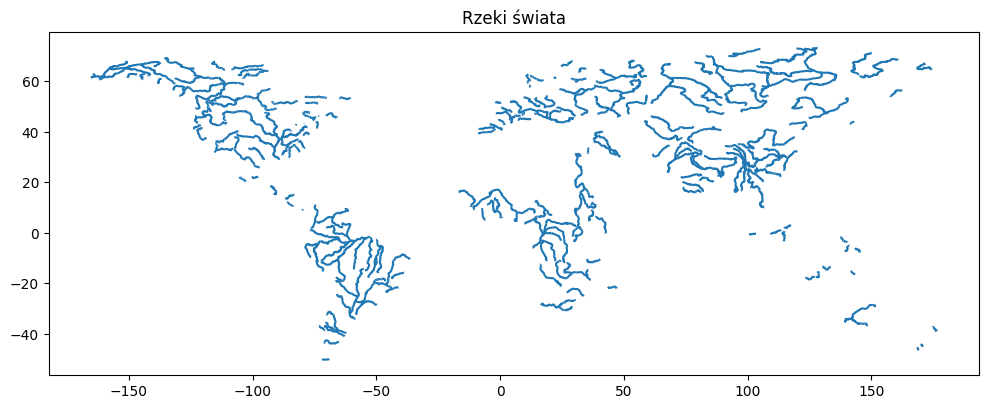

In [22]:
rivers.plot(figsize=(12,6))
plt.title("Rzeki świata")

Wizualizacja powyższych trzech zbiorów danych na jednym wykrsie

Text(0.5, 1.0, 'Mapa świata z naniesionymi miastami i rzekami')

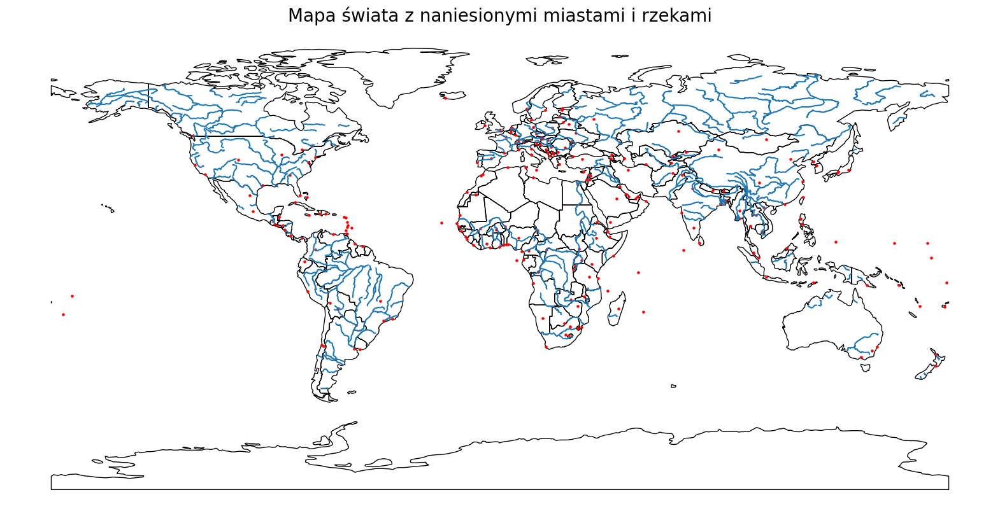

In [23]:
fig, ax = plt.subplots(figsize=(20, 15))
countries.plot(ax=ax, edgecolor='k', facecolor='none')
rivers.plot(ax=ax)
cities.plot(ax=ax, color='red', markersize=5)
ax.set_axis_off()
plt.title("Mapa świata z naniesionymi miastami i rzekami", fontsize=20)

* Zbiór danych „Stacje rowerowe w Paryżu”

In [24]:
stations = geopandas.read_file("paris_bike_stations.gpkg")

In [25]:
stations.head()

,name,bike_stands,available_bikes,geometry
0,14002 - RASPAIL QUINET,44,4,POINT (259324.887 6247620.771)
1,20503 - COURS DE VINCENNES PYRÉNÉES,21,3,POINT (267824.377 6249062.894)
2,20011 - PYRÉNÉES-DAGORNO,21,0,POINT (267742.135 6250378.469)
3,31008 - VINCENNES (MONTREUIL),56,0,POINT (271326.638 6250750.824)
4,43006 - MINIMES (VINCENNES),28,27,POINT (270594.689 6248007.705)


In [26]:
stations.shape

(1226, 4)

In [27]:
stations.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Text(0.5, 1.0, 'Stacje rowerowe w obrębie Paryżu')

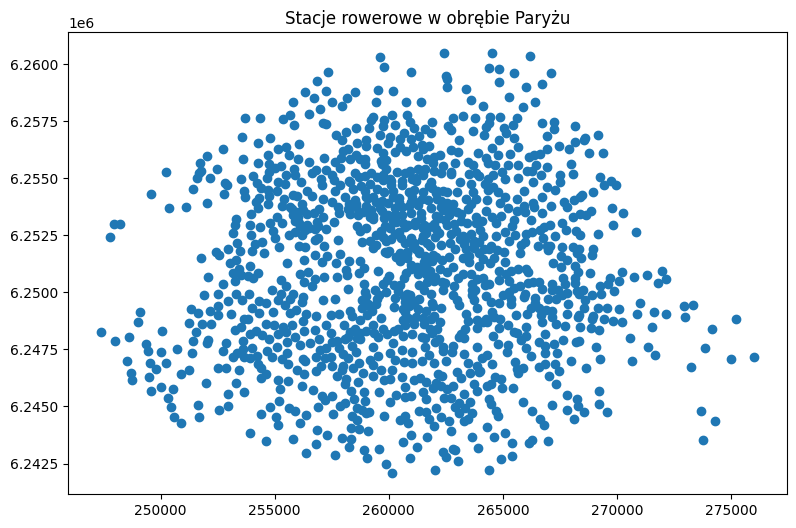

In [28]:
stations.plot(figsize=(12,6))
plt.title("Stacje rowerowe w obrębie Paryżu")

In [29]:
stations.explore()

Text(0.5, 1.0, 'Stacje rowerowe w obrębie Paryżu')

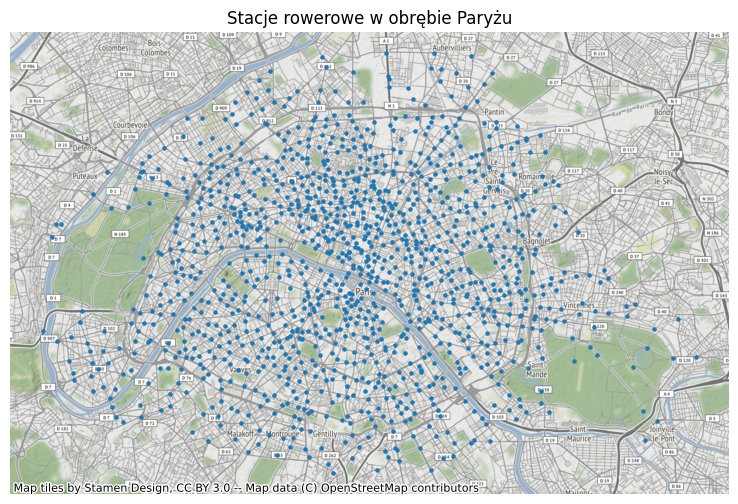

In [30]:
ax = stations.plot(figsize=(12,6), markersize=5)
contextily.add_basemap(ax)
ax.set_axis_off()
plt.title("Stacje rowerowe w obrębie Paryżu")

* Zbiór danych „Dzielnice Paryża”

In [31]:
districts = geopandas.read_file("paris_districts.geojson")

In [32]:
districts.head()

,id,district_name,population,geometry
0,1,St-Germain-l'Auxerrois,1672,"POLYGON ((451922.133 5411438.484, 451922.080 5..."
1,2,Halles,8984,"POLYGON ((452278.419 5412160.893, 452192.407 5..."
2,3,Palais-Royal,3195,"POLYGON ((451553.806 5412340.522, 451528.058 5..."
3,4,Place-Vendôme,3044,"POLYGON ((451004.908 5412654.095, 450960.640 5..."
4,5,Gaillon,1345,"POLYGON ((451328.752 5412991.278, 451294.721 5..."


In [33]:
districts.shape

(80, 4)

In [34]:
districts.crs

<Projected CRS: EPSG:32631>
Name: WGS 84 / UTM zone 31N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 0°E and 6°E, northern hemisphere between equator and 84°N, onshore and offshore. Algeria. Andorra. Belgium. Benin. Burkina Faso. Denmark - North Sea. France. Germany - North Sea. Ghana. Luxembourg. Mali. Netherlands. Niger. Nigeria. Norway. Spain. Togo. United Kingdom (UK) - North Sea.
- bounds: (0.0, 0.0, 6.0, 84.0)
Coordinate Operation:
- name: UTM zone 31N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Text(0.5, 1.0, 'Dzielnice Paryża')

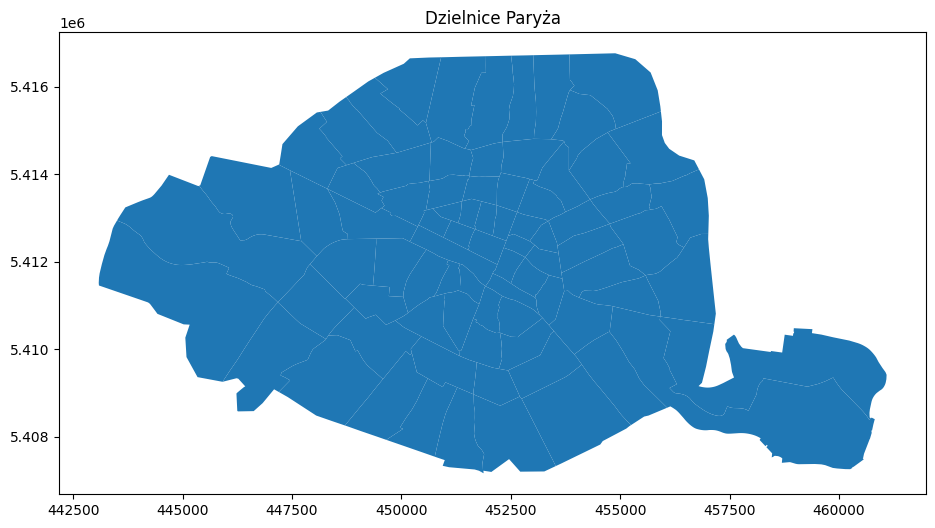

In [35]:
districts.plot(figsize=(12,6))
plt.title("Dzielnice Paryża")

In [36]:
# Zmiana CRS na 'EPSG:3857' -> wymagany przy wizualizacji przy pomocy biblioteki contextily
districts_crs = districts.to_crs(stations.crs)
districts_crs.crs 

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Text(0.5, 1.0, 'Dzielnice Paryża')

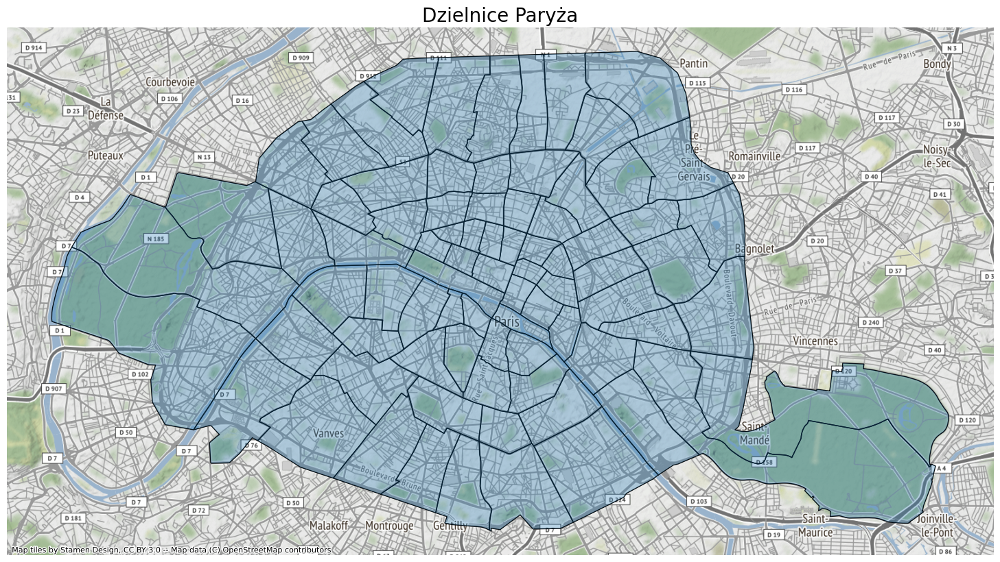

In [37]:
ax = districts_crs.plot(markersize=5, figsize=(20, 10), edgecolor='k', facecolor='none')
districts_crs.plot(ax=ax, alpha=0.3)
contextily.add_basemap(ax, crs=districts_crs.crs)
ax.set_axis_off()
plt.title("Dzielnice Paryża", fontsize=20)


In [38]:
districts.explore()

Wizualizacja powyzszych dwóch zbiorów danych na jednym wykresie

Text(0.5, 1.0, 'Stacje rowerowe w obrębie Paryża wraz z naniesionym rozkładem  jego dzielnic')

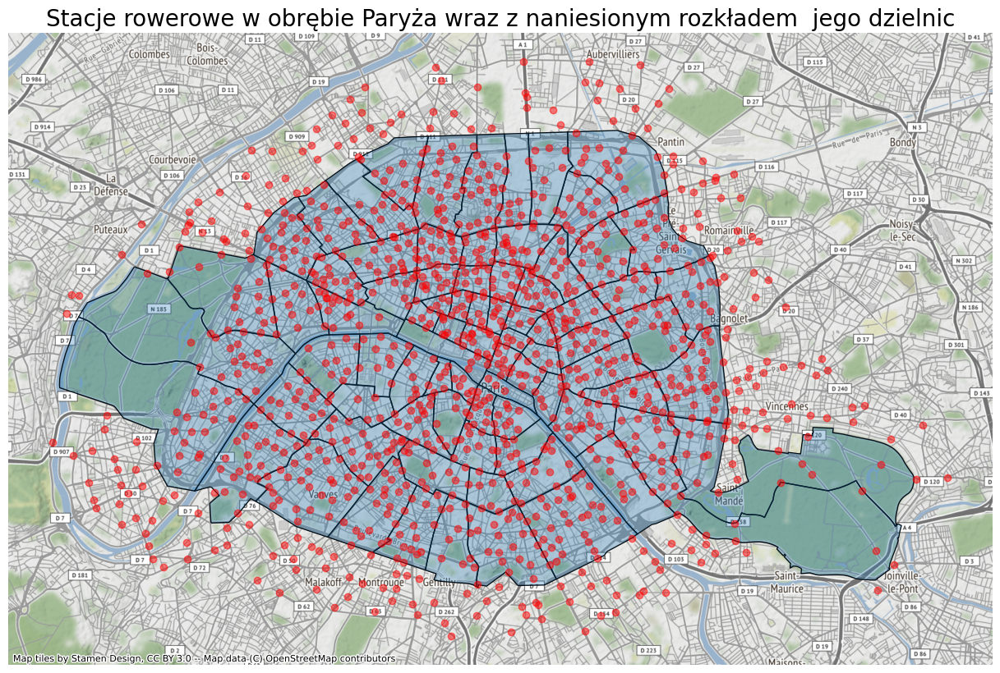

In [39]:
ax = districts_crs.plot(markersize=5, figsize=(20, 10), edgecolor='k', facecolor='none')
districts_crs.plot(ax=ax, alpha=0.3)
stations.plot(ax=ax, color='red', alpha=0.5)
contextily.add_basemap(ax, crs=districts_crs.crs)
ax.set_axis_off()
plt.title("Stacje rowerowe w obrębie Paryża wraz z naniesionym rozkładem  jego dzielnic", fontsize=20)


* Zbiór danych "Tereny użytkowe w Paryżu”

In [41]:
land_use = geopandas.read_file('paris_land_use.zip')

In [42]:
land_use.head()

,class,geometry
0,Water bodies,"POLYGON ((3751386.281 2890064.323, 3751395.345..."
1,Roads and associated land,"POLYGON ((3751390.345 2886000.000, 3751390.345..."
2,Roads and associated land,"POLYGON ((3751390.345 2886898.192, 3751390.370..."
3,Roads and associated land,"POLYGON ((3751390.345 2887500.000, 3751390.345..."
4,Roads and associated land,"POLYGON ((3751390.345 2888647.357, 3751390.370..."


In [43]:
land_use.shape

(3243, 2)

In [44]:
land_use.crs

<Projected CRS: PROJCS["Lambert_Azimuthal_Equal_Area",GEOGCS["GCS_ ...>
Name: Lambert_Azimuthal_Equal_Area
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Lambert Azimuthal Equal Area
Datum: D_unknown
- Ellipsoid: GRS80
- Prime Meridian: Greenwich

Text(0.5, 1.0, 'Grunty użytkowe w Paryżu')

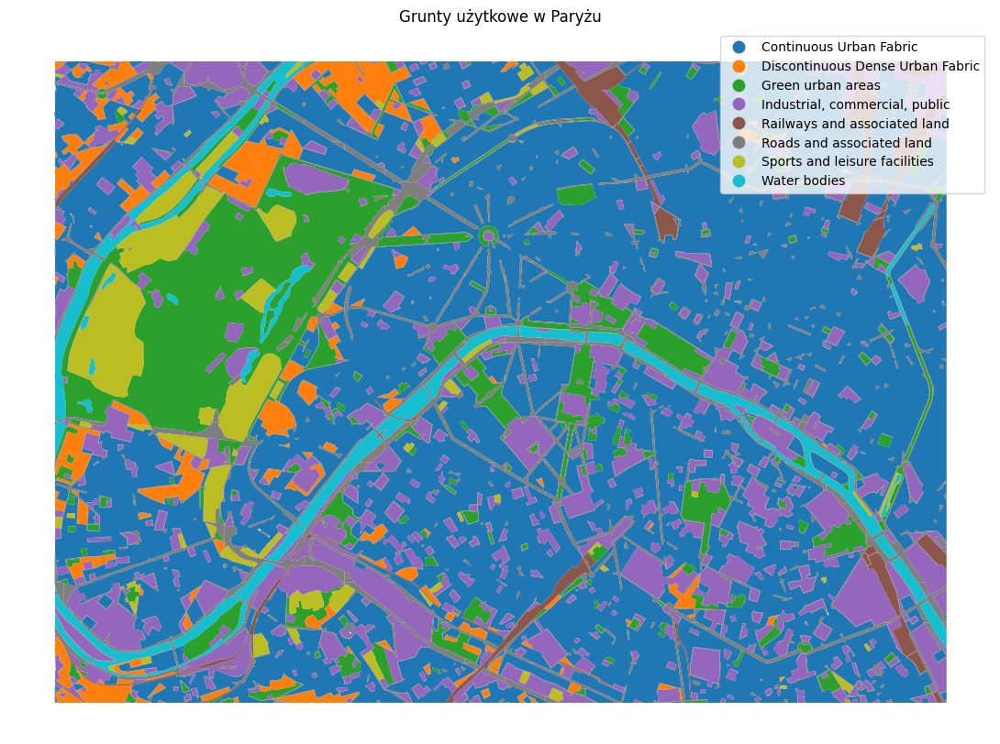

In [45]:
land_use.plot(figsize=(20,10), column='class', legend=True)
plt.axis("off")
plt.title("Grunty użytkowe w Paryżu")

# 2. Upraszczanie danych

Funkcja upraszczania danych pozwala na zmniejszenie liczby wierzchołków w obiektach przestrzennych, co pozwala na zmniejszenie rozmiaru plików i przyspieszenie operacji. W Pythonie do upraszczania danych przestrzennych można użyć funkcji simplify() z biblioteki Shapely.

**Eksperyment  1 - prezentacja działania funkcji simplify()** 

Przykład 1 – różnica długości łamanej przed i po uproszczeniu

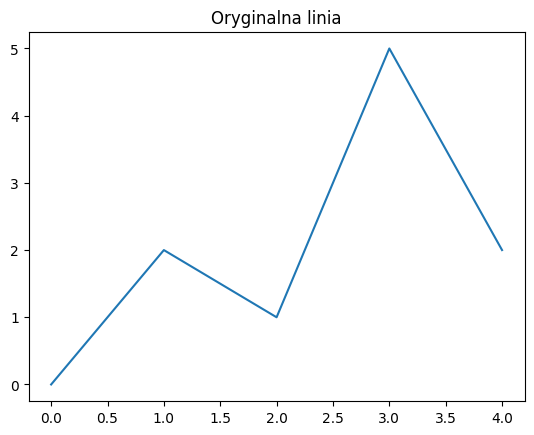

Oryginalna linia: LINESTRING (0 0, 1 2, 2 1, 3 5, 4 2)
Długość oryginalnej linii:  10.935664825658925



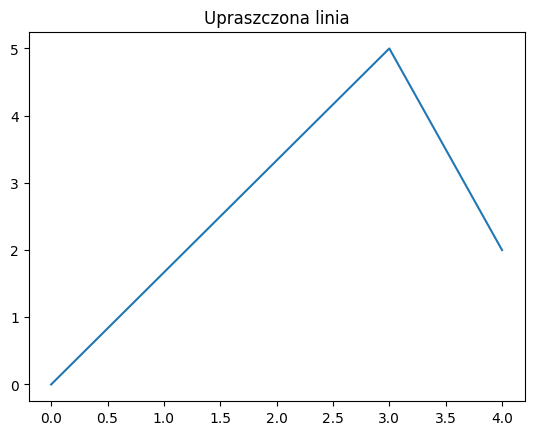

Upraszczona linia: LINESTRING (0 0, 3 5, 4 2)
Długość linii po uproszczeniu:  8.99322955501368


In [46]:
# Przykładowa linii z wieloma wierzchołkami
line = LineString([(0, 0), (1, 2), (2, 1), (3, 5), (4, 2)])

# Wizualizacja przed upraszczaniem
x, y = line.xy
plt.plot(x, y)
plt.title("Oryginalna linia")
plt.show()

# Wyświetlanie wyników przed upraszczaniem
print("Oryginalna linia:", line)
print("Długość oryginalnej linii: ", line.length)
print()

# Upraszczenie linii
simplified_line = line.simplify(2.0)  

# Wizualizacja po upraszczaniu
x, y = simplified_line.xy
plt.plot(x, y)
plt.title("Upraszczona linia")
plt.show()

# Wyświetlanie wyników po upraszczaniu
print("Upraszczona linia:", simplified_line)
print("Długość linii po uproszczeniu: ", simplified_line.length)


Przykład *2* 

Powierzchnia przed upraszacanie:  3.7952236735605873
Powierzchnia po upraszaczanie - tolerancja 0.2:  3.4223968209428905
Powierzchnia po upraszaczanie - tolerancja 0.5:  2.4200000000000004


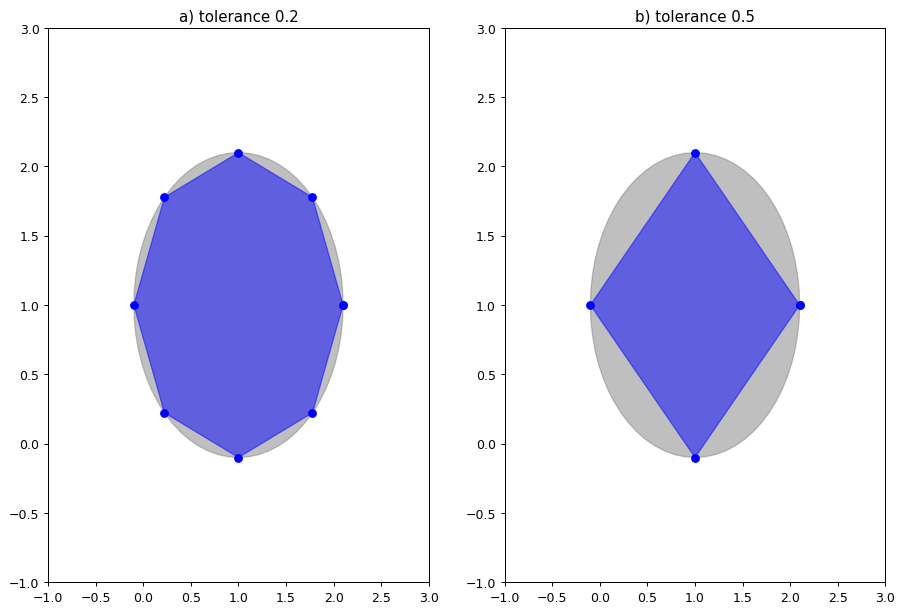

In [47]:
fig = plt.figure(1, figsize=(12,8), dpi=90)

p = Point(1, 1).buffer(1.1)

print(f"Powierzchnia przed upraszacanie: ", p.area)

# 1 - tolerancja = 0.2
ax = fig.add_subplot(121)

q = p.simplify(0.2)
print(f"Powierzchnia po upraszaczanie - tolerancja 0.2: ", q.area)

plot_polygon(p, ax=ax, add_points=False, color='GRAY', alpha=0.5)
plot_polygon(q, ax=ax, add_points=True, color='BLUE', alpha=0.5)

ax.set_title('a) tolerance 0.2')


ax.set_xlim([-1, 3])
ax.set_ylim([-1, 3])

#2 - tolerancja = 0.5
ax = fig.add_subplot(122)

r = p.simplify(0.5)

print(f"Powierzchnia po upraszaczanie - tolerancja 0.5: ", r.area)

plot_polygon(p, ax=ax, add_points=False, color='GRAY', alpha=0.5)
plot_polygon(r, ax=ax, add_points=True, color='BLUE', alpha=0.5)

ax.set_title('b) tolerance 0.5')

ax.set_xlim([-1, 3])
ax.set_ylim([-1, 3])

plt.show()

**Eksperyment  2 - wpływ parametru 'tolerance' na długość upraszczanej łamanej**

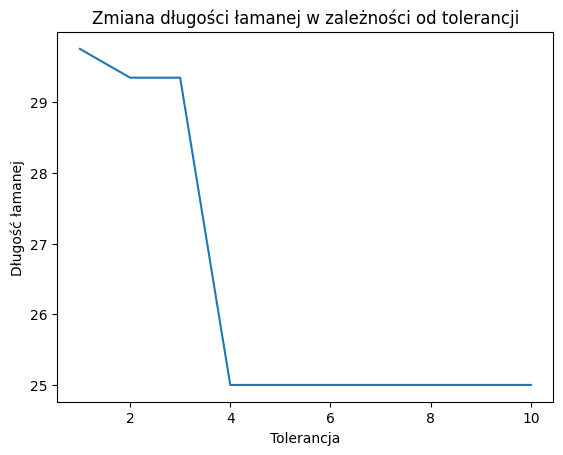

In [48]:
# Utworzenie przykładowej łamanej
line = LineString([(0, 0), (1, 5), (0, 10), (-2, 15), (4, 20), (0, 25)])

# Utworzenie list do przechowywania danych
sizes = []
tolerances = []
line_lengths = []

# Próbkowanie różnych tolerancji
for tolerance in range(1, 11):
    # Zapisywanie tolerancji
    tolerances.append(tolerance)

    # Upraszczenie linii
    simplified_line = line.simplify(tolerance)

    # Wyliczanie długości uproszczonej linii
    line_length = simplified_line.length
    line_lengths.append(line_length)

# Zwizualizuj zmianę długości łamanej w zależności od zadanej tolerancji
plt.plot(tolerances, line_lengths)
plt.xlabel('Tolerancja')
plt.ylabel('Długość łamanej')
plt.title('Zmiana długości łamanej w zależności od tolerancji')
plt.show()

Wizualizacja łamanej dla wartości granicznej tolerancji

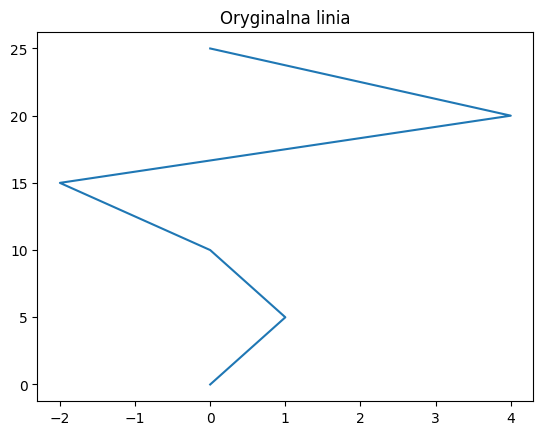

Oryginalna linia: LINESTRING (0 0, 1 5, 0 10, -2 15, 4 20, 0 25)
Długość oryginalnej linii:  29.796577747659576



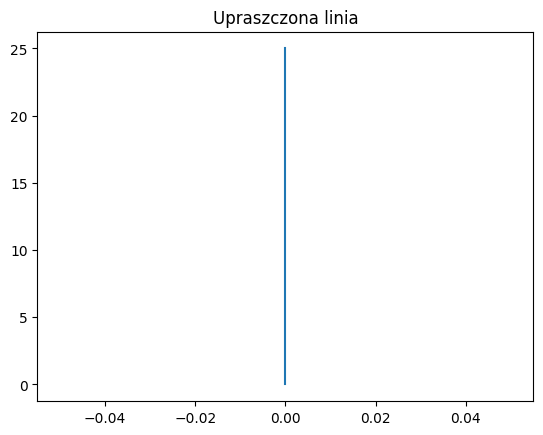

Upraszczona linia: LINESTRING (0 0, 0 25)
Długość linii po uproszczeniu:  25.0


In [49]:
# Przykładowa linii z wieloma wierzchołkami
line = LineString([(0, 0), (1, 5), (0, 10), (-2, 15), (4, 20), (0, 25)])

# Wizualizacja przed upraszczaniem
x, y = line.xy
plt.plot(x, y)
plt.title("Oryginalna linia")
plt.show()

# Wyświetlanie wyników przed upraszczaniem
print("Oryginalna linia:", line)
print("Długość oryginalnej linii: ", line.length)
print()

# Upraszczenie linii
simplified_line = line.simplify(4.0)  

# Wizualizacja po upraszczaniu
x, y = simplified_line.xy
plt.plot(x, y)
plt.title("Upraszczona linia")
plt.show()

# Wyświetlanie wyników po upraszczaniu
print("Upraszczona linia:", simplified_line)
print("Długość linii po uproszczeniu: ", simplified_line.length)


**Eksperyment  3 - czas upraszczania w zależności od liczby punktów**

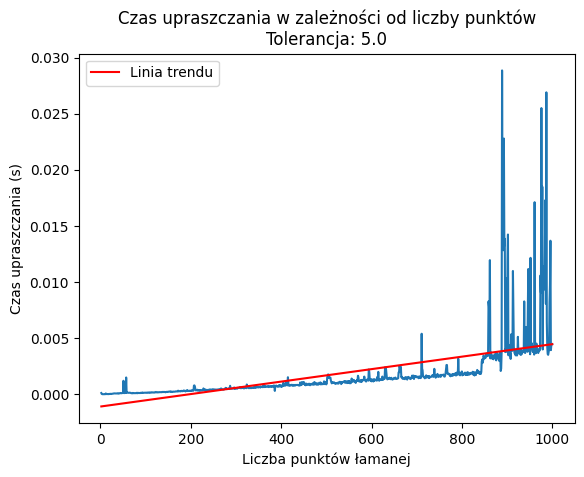

In [50]:
sizes = []
simplification_times = []

tolerance = 5.0

# Próbkowanie różnych długości linii
for size in range(2, 1001):  # Od 1 do 1000 (włącznie)
    # Tworzenie linii o zadanej długości
    line_points = [(i, random.uniform(-5, 5)) for i in range(size)]
    line = LineString(line_points)

    # Pomiar czasu upraszczania
    start_time = time.time()
    simplified_line = line.simplify(tolerance)
    simplification_time = time.time() - start_time

    sizes.append(size)
    simplification_times.append(simplification_time)

# Wykres zależności czasu upraszczania od liczby punktów łamanej
plt.plot(sizes, simplification_times)
plt.xlabel('Liczba punktów łamanej')
plt.ylabel('Czas upraszczania (s)')
plt.title(f'Czas upraszczania w zależności od liczby punktów\nTolerancja: {tolerance}')


# Dopasowanie lini trendu (liniowa regresja)
coefficients = np.polyfit(sizes, simplification_times, 1)
trendline = np.polyval(coefficients, sizes)

# Rysowanie linii trendu w kolorze czerwonym
plt.plot(sizes, trendline, color='red', label='Linia trendu')
plt.legend()
plt.show()


# 3. Wyznaczanie środków oraz buforów

Funkcje te pozwalają na wyznaczanie środków geometrycznych obiektów przestrzennych oraz tworzenie stref buforowych wokół nich. W Pythonie można użyć odpowiednio funkcji centroid() oraz buffer() z biblioteki Shapely.

## Bufor

**Eksperyment 1 - obszar zalewowy rzeki**

In [51]:
# Własnoręcznie zdefiniowana geometria rzeki Sekwany przy pomocy strony internetowej - http://geojson.io 
seine_river = geopandas.GeoDataFrame.from_features({
  "type": "FeatureCollection",
  "features": [
    {
      "type": "Feature",
      "properties": {},
      "geometry": {
        "coordinates": [
          [
            2.3108279881319334,
            48.913570727115314
          ],
          [
            2.275612743068251,
            48.898780521900704
          ],
          [
            2.26157131448565,
            48.89297802282849
          ],
          [
            2.249535804272341,
            48.88110717688289
          ],
          [
            2.2322849062992134,
            48.86844183499784
          ],
          [
            2.226267151192559,
            48.86131617104897
          ],
          [
            2.2242612328233236,
            48.85286962584041
          ],
          [
            2.225865967518132,
            48.846533781610134
          ],
          [
            2.223458865475436,
            48.83729257163333
          ],
          [
            2.227871885887339,
            48.825408510413496
          ],
          [
            2.2415121307964228,
            48.821446530265405
          ],
          [
            2.2623736818335374,
            48.83069066339962
          ],
          [
            2.2760139267426496,
            48.84626977070218
          ],
          [
            2.294468375737125,
            48.861052238084625
          ],
          [
            2.301689681865099,
            48.86342758466097
          ],
          [
            2.317737028816879,
            48.86369150509984
          ],
          [
            2.341406865570093,
            48.85788493394887
          ],
          [
            2.3606636819124276,
            48.849173814137345
          ],
          [
            2.3947642941842275,
            48.82223895135195
          ],
          [
            2.4108116411360356,
            48.816163402845206
          ],
          [
            2.4340802942157893,
            48.81642757244077
          ]
        ],
        "type": "LineString"
      }
    }
  ]
}, crs='EPSG:4326')

In [52]:
# Konwersja crs
seine_utm = seine_river.to_crs(epsg=2154)
districts = districts.to_crs(epsg=2154)

Text(0.5, 1.0, 'Sekwana')

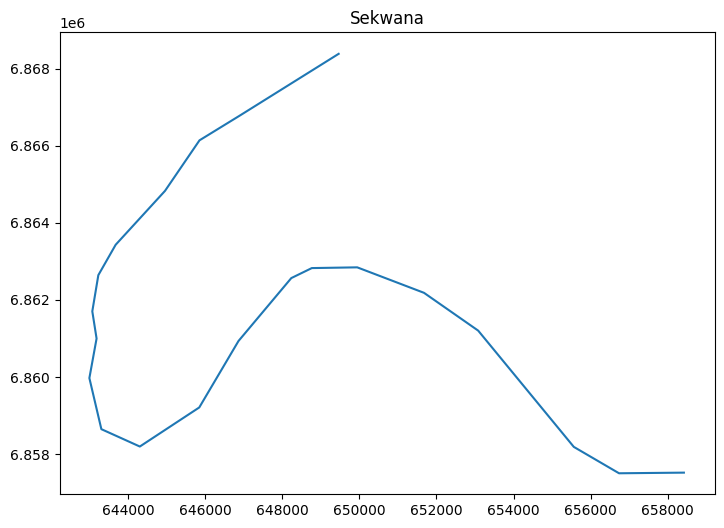

In [53]:
# Wizualizacja Sekwany
seine_utm.plot(figsize=(12,6))
plt.title("Sekwana")

<Axes: >

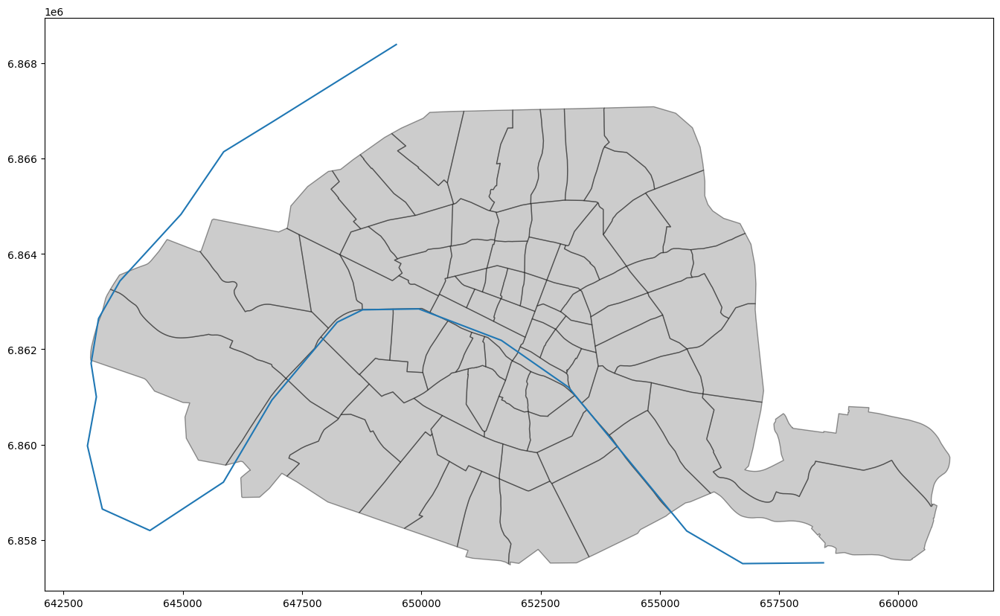

In [54]:
# Wizualizacja Sekwany i dzielnic Paryża
fig, ax = plt.subplots(figsize=(20, 10))
districts.plot(ax=ax, color='grey', alpha=0.4, edgecolor='k')
seine_utm.plot(ax=ax)

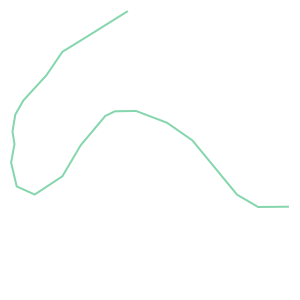

In [55]:
# Geometria Sekwany
seine = seine_utm.geometry.item()
seine

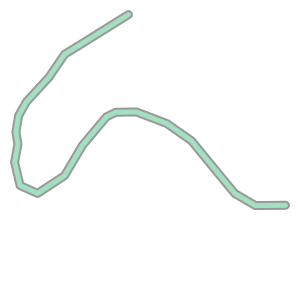

In [56]:
# Geometria Sekwany z buforem równym 200 m (obszar zalewowy)
seine_buffer = seine.buffer(200)
seine_buffer 

In [57]:
# Dataframe z geometrią Sekwany z buforem
buffer_gdf = geopandas.GeoDataFrame(geometry=[seine_buffer], crs=districts.crs)
buffer_gdf

,geometry
0,"POLYGON ((646998.721 6866604.612, 646997.407 6..."


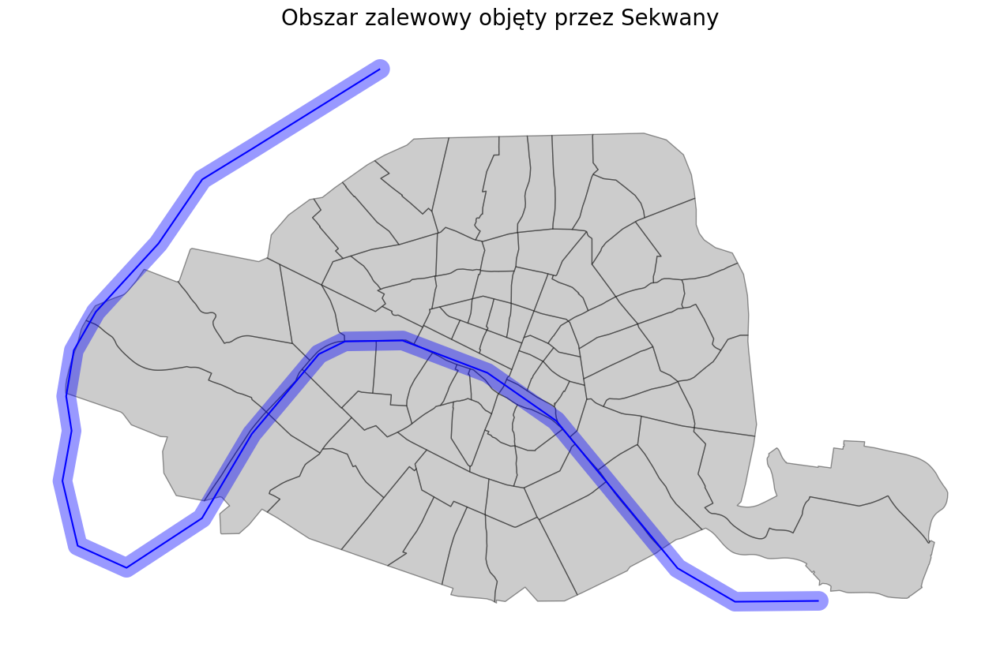

In [58]:
# Wizualizacja Sekwany z buforem
fig, ax = plt.subplots(figsize=(20, 10))
districts.plot(ax=ax, color='grey', alpha=0.4, edgecolor='k')
buffer_gdf.plot(ax=ax, color='blue', alpha=0.4)
seine_utm.plot(ax=ax, color='blue')
plt.title('Obszar zalewowy objęty przez Sekwany', fontsize=20)
plt.axis('off')
plt.show()

In [59]:
# Funkcja intersects() - przecięcia dwóch lub więcej obiektów przestrzennych
districts_seine = districts[districts.intersects(seine_buffer)]

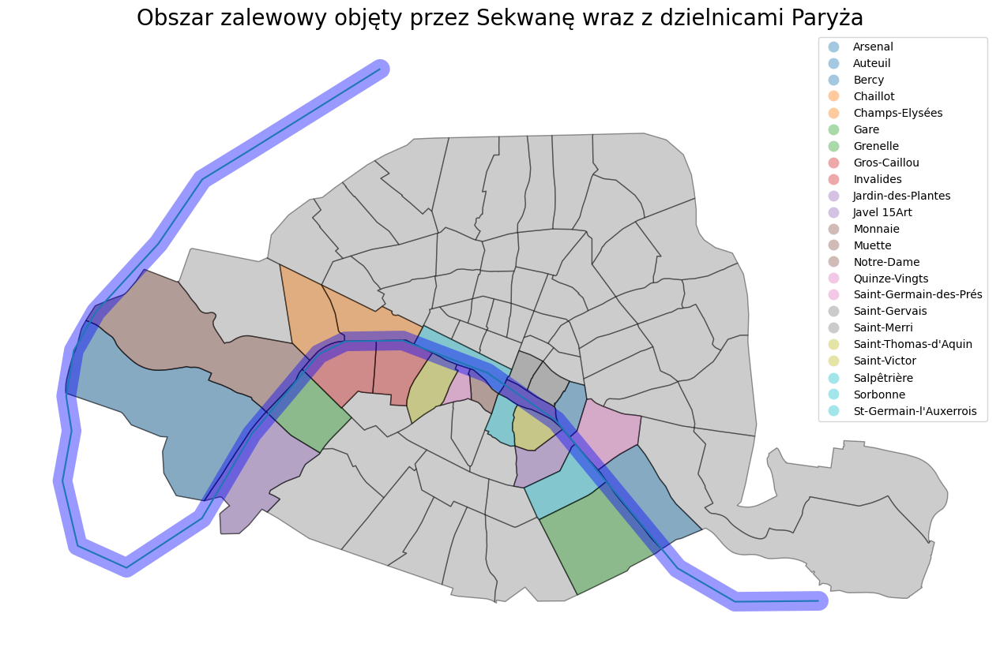

In [60]:
# Wizualizacja 
fig, ax = plt.subplots(figsize=(20, 10))
districts.plot(ax=ax, color='grey', alpha=0.4, edgecolor='k')
districts_seine.plot(ax=ax, alpha=0.4, edgecolor='k', column='district_name', legend=True)
buffer_gdf.plot(ax=ax, color='blue', alpha=0.4)
seine_utm.plot(ax=ax)
ax.set_axis_off()
plt.title('Obszar zalewowy objęty przez Sekwanę wraz z dzielnicami Paryża', fontsize=20)
plt.show()

In [61]:
dangerous_area = districts_seine['district_name']
print(dangerous_area)
print("Liczba zagrożonych dzilnic: ", dangerous_area.size)

0     St-Germain-l'Auxerrois
12               Saint-Merri
13             Saint-Gervais
14                   Arsenal
15                Notre-Dame
16              Saint-Victor
17        Jardin-des-Plantes
19                  Sorbonne
20                   Monnaie
23    Saint-Germain-des-Prés
24      Saint-Thomas-d'Aquin
25                 Invalides
27              Gros-Caillou
28            Champs-Elysées
46                     Bercy
47             Quinze-Vingts
48               Salpêtrière
49                      Gare
58                  Grenelle
59               Javel 15Art
60                   Auteuil
61                    Muette
63                  Chaillot
Name: district_name, dtype: object
Liczba zagrożonych dzilnic:  23


**Eksperyment 2 - detonacja bomby jądrowej wycelowanej w wieżę Eiffla w Paryżu**

In [62]:
# Geometria wiży Eiffla
eiffel_tower = Point(648237.3 , 6862271.9)
print(eiffel_tower)

POINT (648237.3 6862271.9)


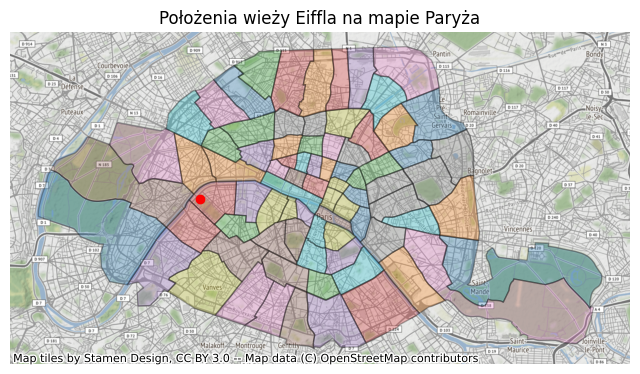

In [63]:
# Wizualizacja położenia wieży Eiffla na mapie Paryża
fig, ax = plt.subplots(figsize=(8, 8))
districts.to_crs(epsg=3857).plot(ax=ax, edgecolor='k', alpha=0.3, column='district_name')
geopandas.GeoSeries([eiffel_tower], crs='EPSG:2154').to_crs(epsg=3857).plot(ax=ax, color='red')
contextily.add_basemap(ax)
plt.title('Położenia wieży Eiffla na mapie Paryża')
ax.set_axis_off()

Opis zniszczeń, zaczynając od najmniejszych powierzchniowo:

1. Żółta strefa: promień 0,78 km – tak duża będzie kula ognia, która dosłownie strawi centrum Warszawy. Nikt w tej części nie będzie miał żadnych szans na przeżycie.

2. Czerwona strefa: promień 1,46 km – ekstremalnie silna fala uderzeniowa, niszcząca niemal całą infrastrukturę naziemną. Szanse na przeżycie zerowe.

3. Zielona strefa: promień 2,14 km – zasięg promieniowania o dawce 5 siwertów (śmiertelność 50% populacji).

4. Niebieska strefa: promień 3,06 km – fala uderzeniowa niszcząca większość budynków mieszkalnych, ale szanse na przeżycie większe od zera i zależą od schronienia (duża przeżywalność w schronach i podziemnych pomieszczeniach).

5. Pomarańczowa strefa: promień 6,33 km – fala ciepła, powodująca głębokie oparzenia 3 stopnia. Potencjalnie śmiertelna, ilość obrażeń zależy od miejsca pobytu i zastosowanej osłony (grube mury, zagłębienia terenu, schrony i piwnice).

6. Jasnopomarańczowa strefa: promień 8,32 km – fala ciepła, powodująca oparzenia 2 stopnia, w większości przypadków niezagrażające życiu.

In [64]:
# Poszczególne strefy zniszczenia spowodowane wybuchem bomby jądrowej
yellow_area = eiffel_tower.buffer(780)
red_area = eiffel_tower.buffer(1460)
green_area = eiffel_tower.buffer(2140)
blue_area = eiffel_tower.buffer(3060)
orange_area = eiffel_tower.buffer(6330)
light_orange_area = eiffel_tower.buffer(8320)

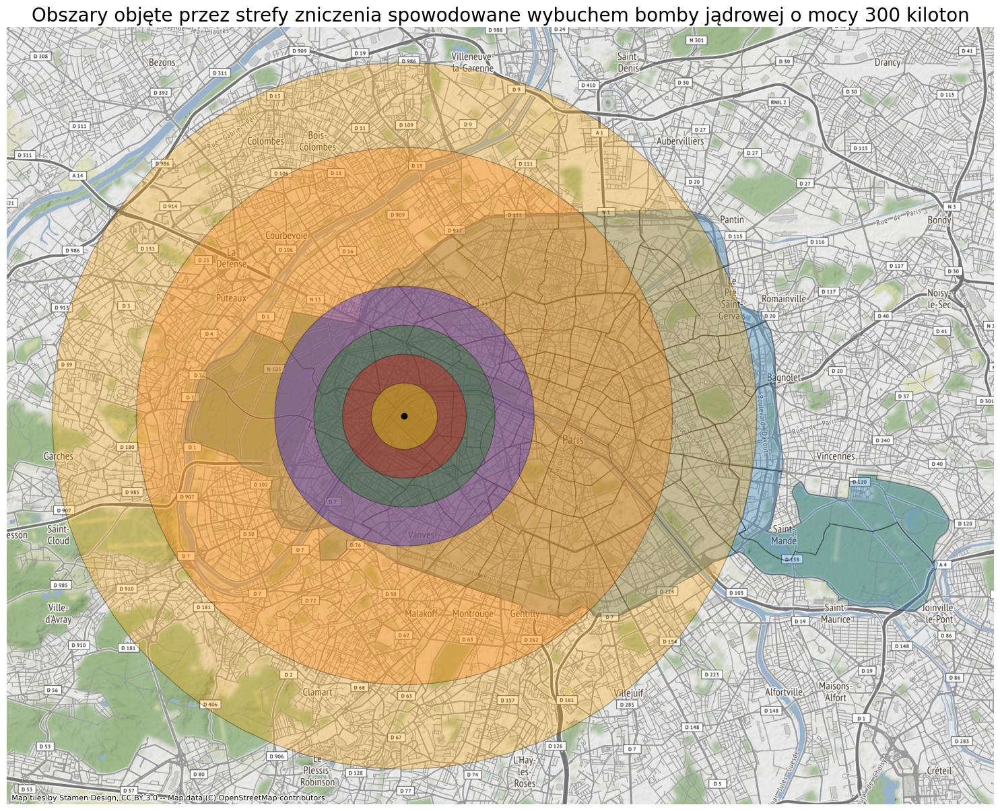

In [65]:
# Wizualizacja stref zniczenia spowodowane wybuchem bomby jądrowej
fig, ax = plt.subplots(figsize=(20, 15))
districts.to_crs(epsg=3857).plot(ax=ax, edgecolor='k', alpha=0.3)
geopandas.GeoSeries([light_orange_area], crs='EPSG:2154').to_crs(epsg=3857).plot(ax=ax, edgecolor='k', alpha=0.3, color='orange')
geopandas.GeoSeries([orange_area], crs='EPSG:2154').to_crs(epsg=3857).plot(ax=ax, edgecolor='k', alpha=0.3, color='C1')
geopandas.GeoSeries([blue_area], crs='EPSG:2154').to_crs(epsg=3857).plot(ax=ax, edgecolor='k', alpha=0.3, color='blue')
geopandas.GeoSeries([green_area], crs='EPSG:2154').to_crs(epsg=3857).plot(ax=ax, edgecolor='k', alpha=0.3, color='green')
geopandas.GeoSeries([red_area], crs='EPSG:2154').to_crs(epsg=3857).plot(ax=ax, edgecolor='k', alpha=0.3, color='red')
geopandas.GeoSeries([yellow_area], crs='EPSG:2154').to_crs(epsg=3857).plot(ax=ax, edgecolor='k', alpha=0.3, color='yellow')
geopandas.GeoSeries([eiffel_tower], crs='EPSG:2154').to_crs(epsg=3857).plot(ax=ax, color='black')
plt.title('Obszary objęte przez strefy zniczenia spowodowane wybuchem bomby jądrowej o mocy 300 kiloton', fontsize= 20)
contextily.add_basemap(ax)
ax.set_axis_off()
plt.show()

In [66]:
# Sprawdzenie, które dzielnice znajdują się wewnątrz obszaru strefy żółtej
destroy_area = districts[districts.intersects(yellow_area)]
result = destroy_area['district_name']

# Wyświetlenie nazw tych dzielnic
print(f'Strefa żółta obejmuje następujące dzielnice: \n{result}')
print(f'Łączna liczba objetych tym obszarem dzielnic: {len(result)}')

Strefa żółta obejmuje następujące dzielnice: 
27      Gros-Caillou
28    Champs-Elysées
58          Grenelle
61            Muette
62    Porte-Dauphine
63          Chaillot
Name: district_name, dtype: object
Łączna liczba objetych tym obszarem dzielnic: 6


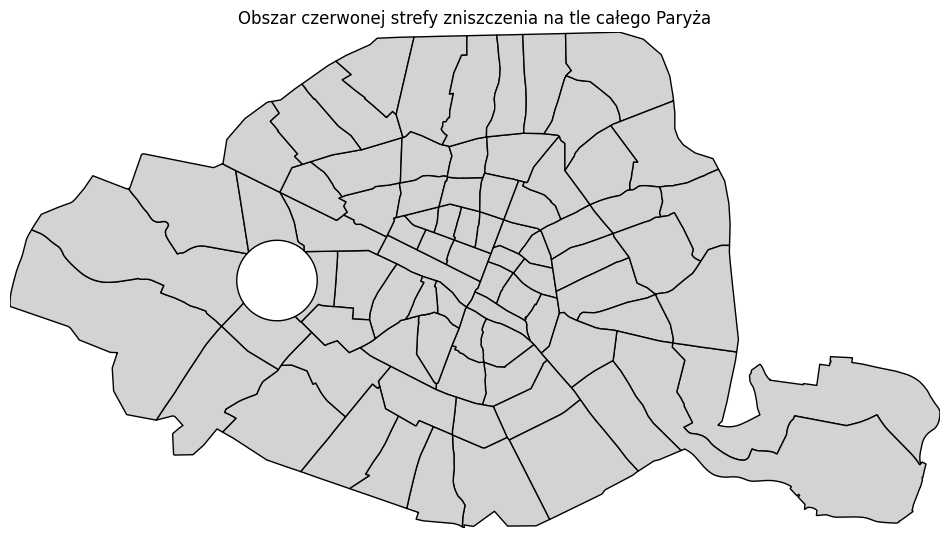

In [67]:
# Różnica między districts a yellow_area
difference_area = districts.difference(yellow_area)

# Nowy geodataframe dla obszaru różnicy
difference_df = geopandas.GeoDataFrame(geometry=difference_area, crs=districts.crs)

# Wizualizacja obszaru różnicy
fig, ax = plt.subplots(figsize=(12, 12))
difference_df.plot(ax=ax, color='lightgray', edgecolor='black')

# Ustawienie ograniczeń osi
ax.set_xlim(districts.total_bounds[0], districts.total_bounds[2])
ax.set_ylim(districts.total_bounds[1], districts.total_bounds[3])

# Usunięcie osi
ax.axis('off')

#  tytuł wykresu
plt.title('Obszar czerwonej strefy zniszczenia na tle całego Paryża')

# Wyświetlenie wizualizacji
plt.show()

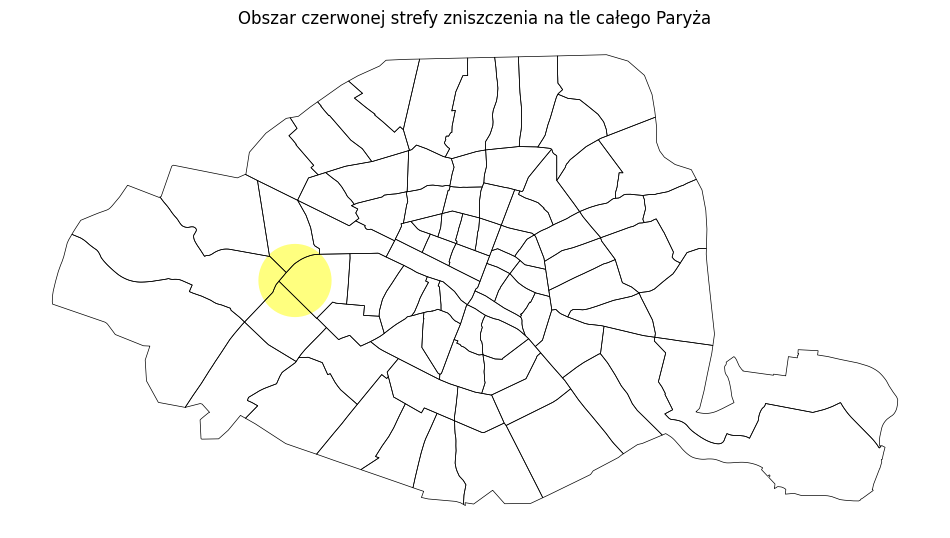

In [68]:
# Wycięcie obszaru wewnątrz yellow_area zawierający dzielnice
area_within_yellow_area = yellow_area.intersection(destroy_area.unary_union)

# Nowy geodataframe dla obszaru wewnątrz yellow_area
districts_within_yellow_area = geopandas.GeoDataFrame(geometry=[area_within_yellow_area], crs=destroy_area.crs)

# Wizualizacja
fig, ax = plt.subplots(figsize=(12, 12))

# Wizualizuj obszar wewnątrz yellow_area
districts_within_yellow_area.plot(ax=ax, color='yellow', alpha=0.5)

# Wizualizuj krawędzie dystryktów
districts.boundary.plot(ax=ax, color='black', linewidth=0.5)

# Usunięcie osi
ax.axis('off')

plt.title('Obszar czerwonej strefy zniszczenia na tle całego Paryża')

# Wyświetlenie wizualizacji
plt.show()

**Eksperyment 3 - wycięcie obszaru przy pomocy bufora**

In [69]:
# Wczytanie Ameryki Południowej
south_america = countries[countries.continent == 'South America']

In [70]:
# Bufor w postaci prostokąta
box = LineString([(-80, 0), (-40, 0)]).buffer(10, cap_style=3)

<Axes: >

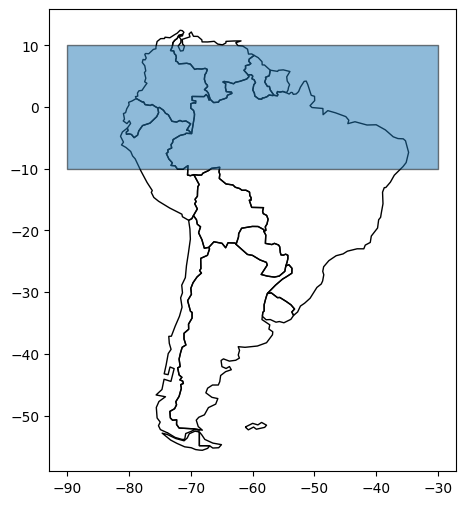

In [71]:
# Wizualizacja bufora na tle Ameryki Południowej
fig, ax = plt.subplots(figsize=(6, 6))
south_america.plot(ax=ax, facecolor='none', edgecolor='k')
geopandas.GeoSeries([box]).plot(ax=ax, facecolor='C0', edgecolor='k', alpha=0.5)

In [72]:
south_america_intersection = south_america.intersection(box)
south_america_intersection.head()

/usr/local/lib/python3.10/dist-packages/shapely/set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)


4                                         POLYGON EMPTY
21    POLYGON ((-66.64691 -9.93133, -65.33844 -9.761...
22    POLYGON ((-65.33844 -9.76199, -66.64691 -9.931...
29                                        POLYGON EMPTY
35    POLYGON ((-67.06505 1.13011, -67.26000 1.72000...
dtype: geometry

<Axes: >

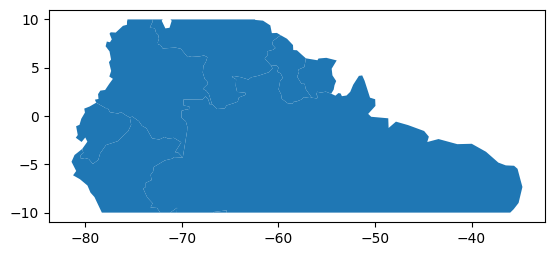

In [73]:
# Usubięcie pustych poligon-ów (kraje, które nie przeinaja się z buforem)
south_america_intersection = south_america_intersection[~south_america_intersection.is_empty]
# Wizualizacja efektu przecęcia
south_america_intersection.plot()

## Wyznaczanie środków

**Eksperyment 1 - średki geometryczne dzielnic w Paryżu**

In [74]:
# Wyznaczenie centroidów dla każdej z dzilnic Paryża
districts['centroid']=districts.centroid
districts.head()

,id,district_name,population,geometry,centroid
0,1,St-Germain-l'Auxerrois,1672,"POLYGON ((651908.563 6861756.318, 651908.510 6...",POINT (651204.300 6862496.156)
1,2,Halles,8984,"POLYGON ((652264.717 6862479.030, 652178.752 6...",POINT (651938.581 6862672.260)
2,3,Palais-Royal,3195,"POLYGON ((651539.853 6862658.479, 651514.121 6...",POINT (651310.610 6862941.143)
3,4,Place-Vendôme,3044,"POLYGON ((650990.707 6862971.961, 650946.460 6...",POINT (650745.971 6863208.195)
4,5,Gaillon,1345,"POLYGON ((651314.531 6863309.339, 651280.525 6...",POINT (651103.905 6863459.594)


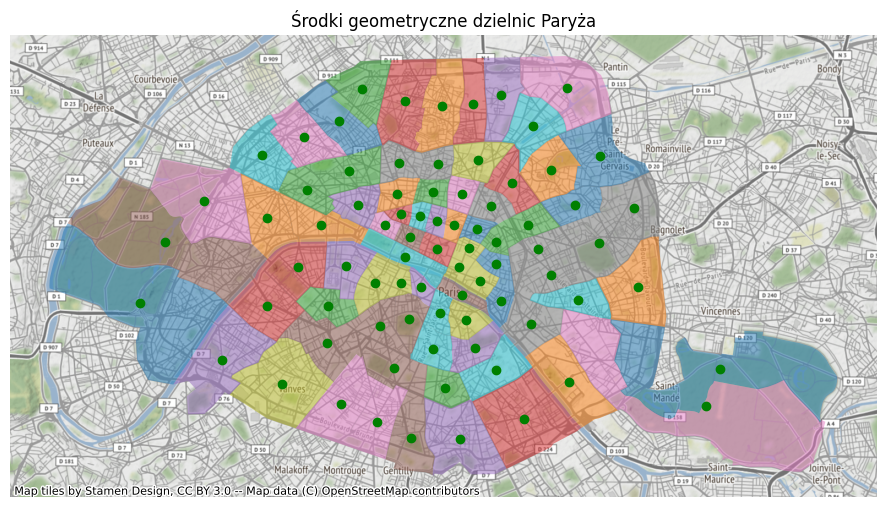

In [75]:
# Wizualizacja centroidów
ax = districts.plot(column='district_name', figsize=(12,6), alpha=0.5)
districts["centroid"].plot(ax=ax, color="green")
contextily.add_basemap(ax, crs=districts.crs.to_string())
plt.title('Środki geometryczne dzielnic Paryża')
plt.axis('off')
plt.show()

# 4. Przycinanie obiektów

Funkcja ta pozwala na przycięcie obiektów przestrzennych do określonego obszaru. W Pythonie można użyć np. funkcji intersection() z biblioteki Shapely.

**Ekperyment 1 - zurbonizowanie dzielnicy Paryża**

In [76]:
# wyznaczenie powierzchni danego terenu
land_use['area'] = land_use.geometry.area
land_use.head()

,class,geometry,area
0,Water bodies,"POLYGON ((3751386.281 2890064.323, 3751395.345...",294578.751217
1,Roads and associated land,"POLYGON ((3751390.345 2886000.000, 3751390.345...",5420.710856
2,Roads and associated land,"POLYGON ((3751390.345 2886898.192, 3751390.370...",2949.568985
3,Roads and associated land,"POLYGON ((3751390.345 2887500.000, 3751390.345...",8475.451252
4,Roads and associated land,"POLYGON ((3751390.345 2888647.357, 3751390.370...",400.972555


In [77]:
# Całkowita powierzchnia dla danej klasy terenu (w m^2)
total_area = land_use.groupby('class')['area'].sum() / 1000**2
total_area.sort_values().to_frame()

,area
class,
Railways and associated land,1.935793
Water bodies,3.189706
Sports and leisure facilities,3.578509
Discontinuous Dense Urban Fabric,3.657343
Roads and associated land,7.401574
Green urban areas,9.858438
"Industrial, commercial, public",13.295042
Continuous Urban Fabric,45.943090


In [78]:
# Zmiana CRS
districts = districts.to_crs(land_use.crs)

In [79]:
# Definicja badanych obszarów
land_use['area'] = land_use.geometry.area
park_boulogne = land_use[land_use['class'] == "Green urban areas"].sort_values('area').geometry.iloc[-1] # Lasek Buloński
auteuil = districts[districts.district_name == 'Auteuil'].geometry.item()

Text(0.5, 1.0, 'Przecięcie się Lasku Bulońskiego z dzielnicą Auteuil')

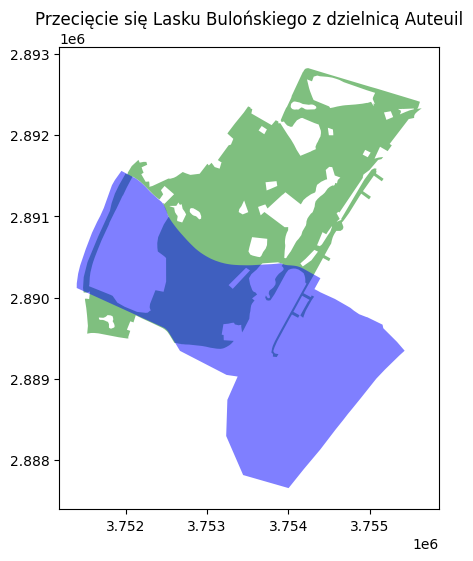

In [84]:
# Wizualizacja
geopandas.GeoSeries([park_boulogne, auteuil]).plot(alpha=0.5, color=['green', 'blue'], figsize=(12,6))
plt.title("Przecięcie się Lasku Bulońskiego z dzielnicą Auteuil")

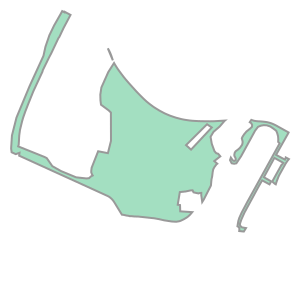

In [85]:
# Przecięcie Laseku Bulońskiego i dzielnicy Auteuil
intersection = park_boulogne.intersection(auteuil)
intersection

Text(0.5, 1.0, 'Część wspólna Lasku Bulońskiego z dzielnicą Auteuil')

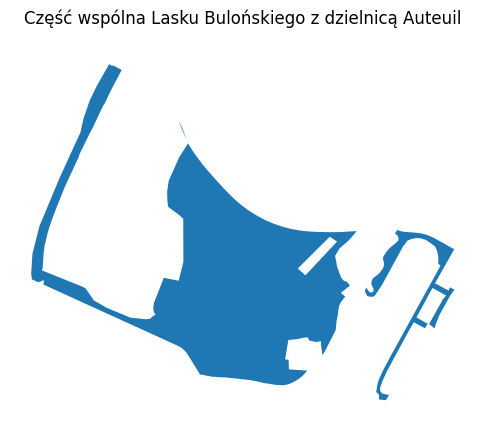

In [86]:
geopandas.GeoSeries([intersection]).plot()
plt.axis("off")
plt.title("Część wspólna Lasku Bulońskiego z dzielnicą Auteuil")

In [87]:
# Stosunek powierzchni przecięcia dwóch obszarów geometrycznych (intersection) do powierzchni całego obszaru  dzielnicy (Auteuil)
print("Stosunek powierzchni przecięcia dwóch obszarów geometrycznych (intersection) do powierzchni całego obszaru  dzielnicy (Auteuil) wynosi: ", intersection.area / auteuil.area)

Stosunek powierzchni przecięcia dwóch obszarów geometrycznych (intersection) do powierzchni całego obszaru  dzielnicy (Auteuil) wynosi:  0.23233818018407196


In [88]:
# Przecięcie wszystkich powierzchni użytkowych z dzielnicą Auteuil
land_use_auteuil = land_use.intersection(auteuil)
land_use_auteuil.head()

/usr/local/lib/python3.10/dist-packages/shapely/set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)


0    POLYGON ((3751395.345 2890118.002, 3751395.960...
1                                        POLYGON EMPTY
2                                        POLYGON EMPTY
3                                        POLYGON EMPTY
4                                        POLYGON EMPTY
dtype: geometry

In [89]:
# Usuniecie gemetrii pustych (nie przecinających się)
land_use_auteuil = land_use_auteuil[~land_use_auteuil.is_empty]
land_use_auteuil.head()

0      POLYGON ((3751395.345 2890118.002, 3751395.960...
73     MULTIPOLYGON (((3753242.941 2888422.165, 37532...
134    POLYGON ((3751522.057 2890061.482, 3751558.949...
135    MULTIPOLYGON (((3751558.949 2890075.140, 37515...
171    POLYGON ((3751626.627 2890500.000, 3751624.813...
dtype: geometry

Text(0.5, 1.0, 'Przecięcie się gruntów użytkowych z dzielnicą Auteuil')

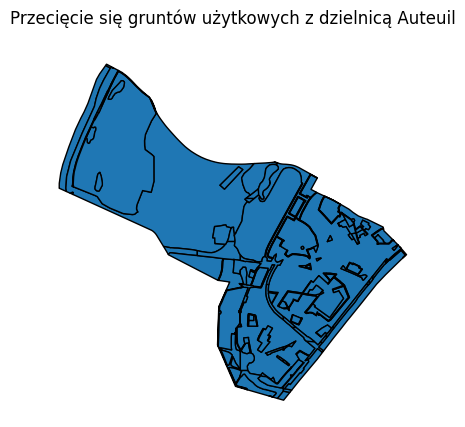

In [90]:
# Wizualizacja
land_use_auteuil.plot(edgecolor='black')
plt.axis("off")
plt.title("Przecięcie się gruntów użytkowych z dzielnicą Auteuil")

In [92]:
# Dodanie nowej geometrii (część wspólna przecinających sie gruntów użytkowuch z dzielnicą Auteuil)
land_use_auteuil = land_use.copy()
land_use_auteuil['geometry'] = land_use.geometry.intersection(auteuil)
land_use_auteuil = land_use_auteuil[~land_use_auteuil.is_empty]
land_use_auteuil.head()

/usr/local/lib/python3.10/dist-packages/shapely/set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)


,class,geometry,area
0,Water bodies,"POLYGON ((3751395.345 2890118.002, 3751395.960...",2.945788e+05
73,Continuous Urban Fabric,"MULTIPOLYGON (((3753242.941 2888422.165, 37532...",1.788807e+06
134,Roads and associated land,"POLYGON ((3751522.057 2890061.482, 3751558.949...",1.621907e+03
135,Green urban areas,"MULTIPOLYGON (((3751558.949 2890075.140, 37515...",5.296073e+06
171,Roads and associated land,"POLYGON ((3751626.627 2890500.000, 3751624.813...",2.666926e+03


Text(0.5, 1.0, 'Rozkład powierzchni zajmowanej przez daną klasę terenu w dzielnicy Auteuil')

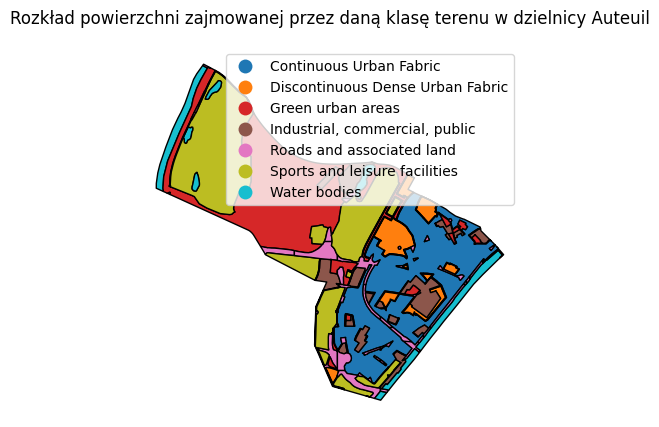

In [93]:
land_use_auteuil.plot(column="class", edgecolor="black", legend=True) 
plt.axis("off")
plt.title("Rozkład powierzchni zajmowanej przez daną klasę terenu w dzielnicy Auteuil")

In [94]:
land_use_auteuil.dissolve(by='class')

,geometry,area
class,,
Continuous Urban Fabric,"MULTIPOLYGON (((3753394.805 2887948.912, 37534...",1.788807e+06
Discontinuous Dense Urban Fabric,"MULTIPOLYGON (((3753515.331 2887991.818, 37535...",1.423575e+04
Green urban areas,"MULTIPOLYGON (((3753393.043 2888063.632, 37533...",5.296073e+06
"Industrial, commercial, public","MULTIPOLYGON (((3753551.570 2888300.291, 37535...",6.421486e+04
Roads and associated land,"MULTIPOLYGON (((3753445.640 2887837.578, 37534...",1.621907e+03
Sports and leisure facilities,"MULTIPOLYGON (((3753917.569 2887733.297, 37538...",9.763379e+05
Water bodies,"MULTIPOLYGON (((3754066.127 2887734.232, 37540...",2.945788e+05


In [95]:
land_use_auteuil['area'] = land_use_auteuil.geometry.area
land_use_auteuil.head()

,class,geometry,area
0,Water bodies,"POLYGON ((3751395.345 2890118.002, 3751395.960...",1.207395e+05
73,Continuous Urban Fabric,"MULTIPOLYGON (((3753242.941 2888422.165, 37532...",1.940429e+03
134,Roads and associated land,"POLYGON ((3751522.057 2890061.482, 3751558.949...",5.459886e+02
135,Green urban areas,"MULTIPOLYGON (((3751558.949 2890075.140, 37515...",1.483552e+06
171,Roads and associated land,"POLYGON ((3751626.627 2890500.000, 3751624.813...",2.666926e+03


In [96]:
# Łączna powierzchnia poszczególnych rodzajów gruntów użytkowych zawarta w dzilnicy Auteuil
result = land_use_auteuil.groupby('class')['area'].sum() / 1000**2
result.sort_values().to_frame()

,area
class,
Discontinuous Dense Urban Fabric,0.296282
Water bodies,0.344668
"Industrial, commercial, public",0.419424
Roads and associated land,0.486358
Continuous Urban Fabric,1.496137
Green urban areas,1.577429
Sports and leisure facilities,1.766351


In [97]:
# Procent powierzchnia zajmowanej przez poszczególne gruntów użytkowych w stosunku do powierzchni dzielnicy Auteuil
percentage_result = land_use_auteuil.groupby("class")["area"].sum() / land_use_auteuil.geometry.area.sum() * 100
percentage_result.sort_values().to_frame()

,area
class,
Discontinuous Dense Urban Fabric,4.639087
Water bodies,5.396698
"Industrial, commercial, public",6.567202
Roads and associated land,7.615233
Continuous Urban Fabric,23.426005
Green urban areas,24.698847
Sports and leisure facilities,27.656929


# 6. Tworzenie unii geometrycznych

Funkcja ta pozwala na tworzenie unii geometrycznych z kilku obiektów przestrzennych. W Pythonie można użyć funkcji union() oraz unary_union() z biblioteki Shapely.

**Eksperyment 1 - unia Szwecji i Finlandii**

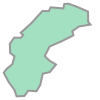

In [98]:
# Geometria Szwecji
sweden = countries[countries['name'] == 'Sweden']
sweden.unary_union

In [99]:
sweden

,iso_a3,name,continent,pop_est,gdp_md_est,geometry
151,SWE,Sweden,Europe,9960487.0,498100.0,"POLYGON ((20.64559 69.10625, 21.97853 68.61685..."


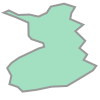

In [100]:
# Geometria Finlandii
finland = countries[countries['name'] == 'Finland']
finland.unary_union

In [101]:
finland

,iso_a3,name,continent,pop_est,gdp_md_est,geometry
52,FIN,Finland,Europe,5491218.0,224137.0,"POLYGON ((23.90338 66.00693, 23.56588 66.39605..."


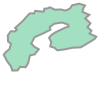

In [102]:
# Unia Finlandii i Szwecji
union  = finland.unary_union.union(sweden.unary_union)
union

In [103]:
geopandas.GeoSeries(union)

0    POLYGON ((21.24494 69.37044, 22.35624 68.84174...
dtype: geometry

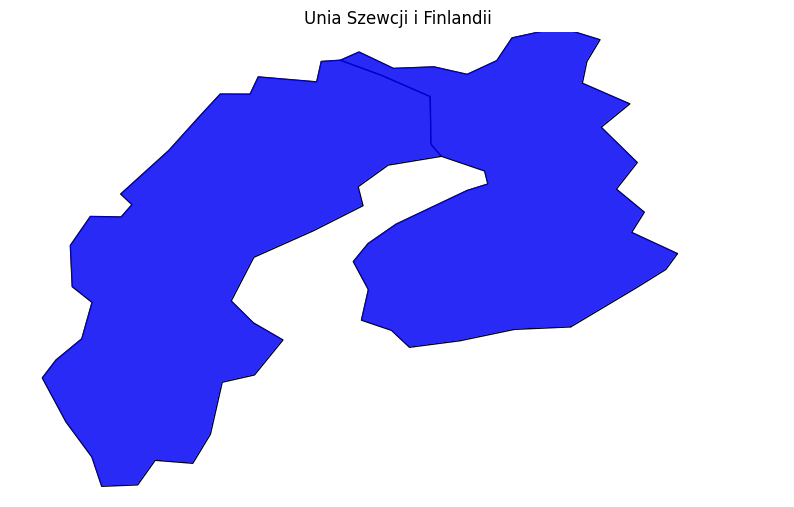

In [104]:
# Konwersja do GeoDataFrame
union_gdf = geopandas.GeoDataFrame(geometry=[union])

# Tworzenie wizualizacji
fig, ax = plt.subplots(figsize=(10, 10))

# Wizualizacja Szwecji
sweden.plot(ax=ax, color='lightgray', edgecolor='black')

# Wizualizacja Finlandii
finland.plot(ax=ax, color='lightgray', edgecolor='black')

# Wizualizacja obszaru, który obejmuje zarówno Szwecję i Finlandię
union_gdf.plot(ax=ax, color='blue', alpha=0.8)

# Ustawienie ograniczeń osi
ax.set_xlim([10, 35])
ax.set_ylim([55, 70])

# Tytył wykresu
plt.title('Unia Szewcji i Finlandii')


plt.axis('off')

# Wyświetlenie wizualizacji
plt.show()

**Eksperyment 2 - unia państw Bliskiego Wschodu**

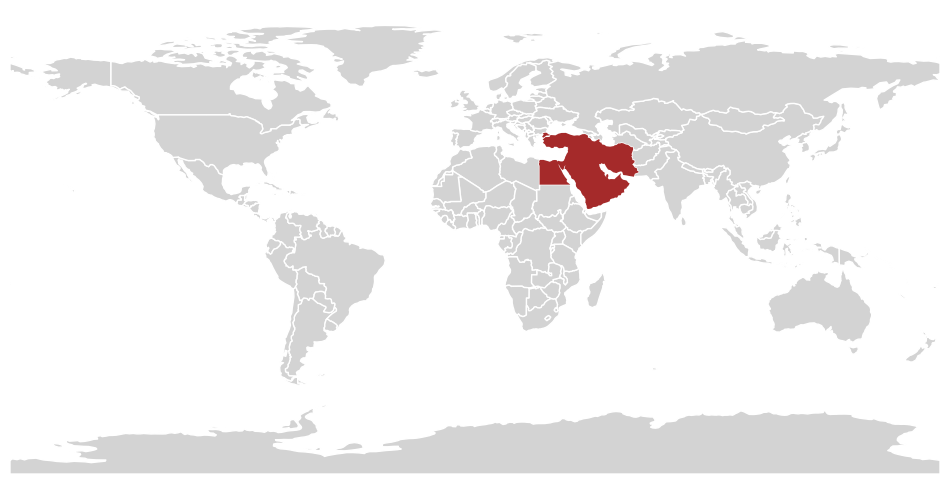

In [105]:
near_east_countries = ['Saudi Arabia', 'United Arab Emirates', 'Egypt', 'Oman', 'Iraq', 'Iran', 'Syria', 'Israel', 'Jordan', 'Palestine', 'Qatar', 'Yemen', 'Kuwait', 'Turkey', 'Lebanon']

# Wybór krajów Bliskiegi Wschodu
near_east_countries_df = countries[countries['name'].isin(near_east_countries)]

# Wyznaczenie unii krajów
union = near_east_countries_df.geometry.unary_union

# Tworzenie wizualizacji
fig, ax = plt.subplots(figsize=(12, 8))

# Wizualizacja świata
countries.plot(ax=ax, color='lightgray', edgecolor='white')

# Wizualizacja unii krajów Bliskiego Wschodu
geopandas.GeoSeries(union).plot(ax=ax, color='brown')

# Ustawienie ograniczeń osi
ax.set_xlim([-180, 180])
ax.set_ylim([-90, 90])

# Usunięcie osi
ax.axis('off')

# Wyświetlenie wizualizacji
plt.show()

In [106]:
near_east_countries_df

,iso_a3,name,continent,pop_est,gdp_md_est,geometry
3,ARE,United Arab Emirates,Asia,6072475.0,667200.00,"POLYGON ((51.57952 24.24550, 51.75744 24.29407..."
47,EGY,Egypt,Africa,97041072.0,1105000.00,"POLYGON ((36.86623 22.00000, 32.90000 22.00000..."
75,IRN,Iran,Asia,82021564.0,1459000.00,"POLYGON ((61.21082 35.65007, 60.80319 34.40410..."
76,IRQ,Iraq,Asia,39192111.0,596700.00,"POLYGON ((44.77268 37.17044, 45.42062 35.97755..."
78,ISR,Israel,Asia,8299706.0,297000.00,"POLYGON ((34.82324 29.76108, 34.26544 31.21936..."
81,JOR,Jordan,Asia,10248069.0,86190.00,"POLYGON ((38.79234 33.37869, 39.19547 32.16101..."
89,KWT,Kuwait,Asia,2875422.0,301100.00,"POLYGON ((46.56871 29.09903, 47.30262 30.05907..."
91,LBN,Lebanon,Asia,6229794.0,85160.00,"POLYGON ((35.82110 33.27743, 35.55280 33.26427..."
121,OMN,Oman,Asia,3424386.0,173100.00,"MULTIPOLYGON (((56.26104 25.71461, 56.07082 26..."
132,PSX,Palestine,Asia,4543126.0,21220.77,"POLYGON ((35.39756 31.48909, 34.92741 31.35344..."


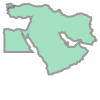

In [107]:
union

In [108]:
geopandas.GeoSeries(union)

0    MULTIPOLYGON (((25.00000 25.68250, 25.00000 29...
dtype: geometry

# 7. Transformacje afiniczne

Transformacje afiniczne pozwalają na przekształcanie obiektów przestrzennych za pomocą kombinacji przesunięć, obrótów, skalowania i przekształceń symetrycznych. W Pythonie można użyć funkcji affine_transform() lub określonej transformacji tj. rotate(), scale(), translate() z biblioteki Shapely.

Funkcje:
* rotate(): Funkcja ta służy do obracania geometrii obiektów przestrzennych o określony kąt.

Zastosowanie: 
Analiza przestrzenna: Obracanie geometrii obiektów przestrzennych może pomóc w analizie ich położenia względem innych obiektów, na przykład w określeniu nachylenia terenu lub orientacji dróg.

* scale(): Funkcja ta służy do skalowania geometrii obiektów przestrzennych przez zmianę ich rozmiaru.

Zastosowanie: 
Analiza przestrzenna: Skalowanie geometrii obiektów przestrzennych może pomóc w analizie ich wielkości względem innych obiektów, na przykład w określeniu powierzchni zabudowy lub obszarów rolniczych.

* translate(): Funkcja ta służy do przesuwania geometrii obiektów przestrzennych o określoną odległość w poziomie i pionie

Zastosowanie: 
Analiza przestrzenna: Przesuwanie geometrii obiektów przestrzennych może pomóc w analizie ich położenia względem innych obiektów, na przykład w określeniu odległości między budynkami lub drogami


**Eksperyment 1 - porównanie wielkości unii krajów Bliskiego Wschodu z Europą**

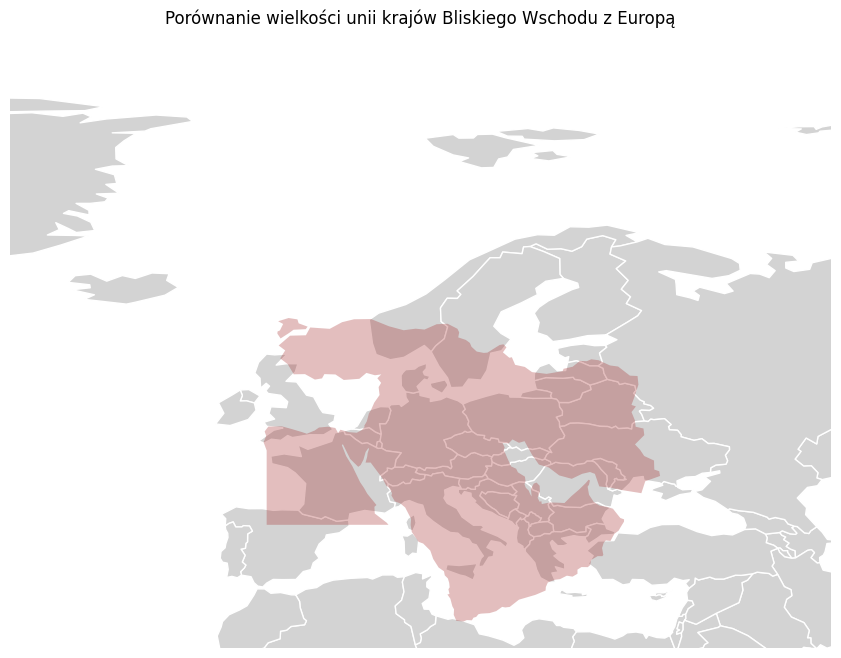

In [109]:
# Transformacja afiniczna - przesunięcie o (-30, 20) wzdłuż osi x i y
translated_union = translate(union, xoff=-30, yoff=20)

# Tworzenie wizualizacji
fig, ax = plt.subplots(figsize=(12, 8))

# Wizualizacja świata
countries.plot(ax=ax, color='lightgray', edgecolor='white')

# Wizualizacja unii krajów Near East na terenie Europy
geopandas.GeoSeries(translated_union).plot(ax=ax, color='brown', alpha=0.3)

# Ustawienie ograniczeń osi
ax.set_xlim([-30, 50])
ax.set_ylim([30, 90])

# Usunięcie osi
ax.axis('off')

plt.title('Porównanie wielkości unii krajów Bliskiego Wschodu z Europą')

# Wyświetlenie wizualizacji
plt.show()

**Eksperyment 2 - porówanie wielkości Australi z Europą**

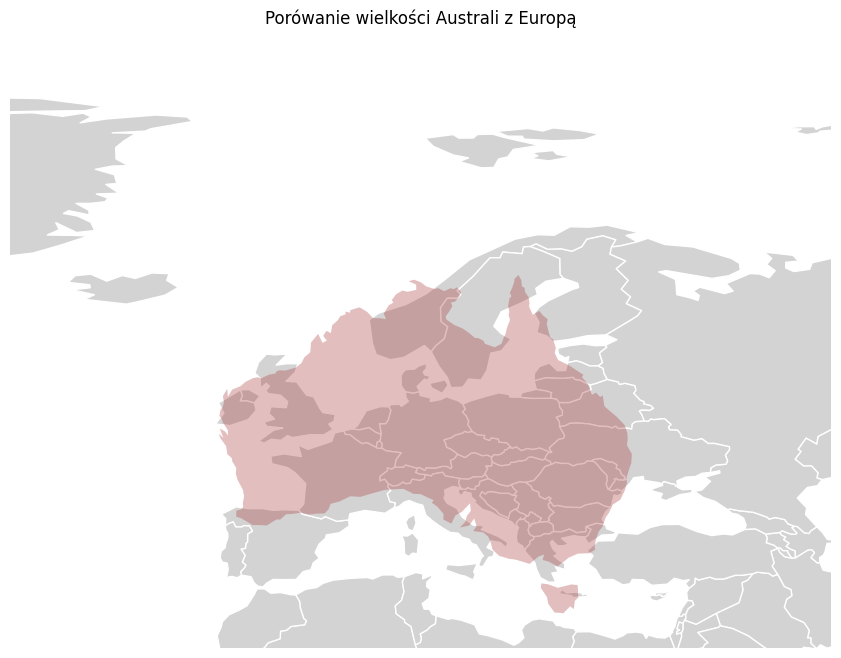

In [110]:
# Wybór kraju Australia
australia = countries[countries['name'] == 'Australia']

# Przesunięcie Australii o (-30, 20) wzdłuż osi x i y
translated_australia = translate(australia.geometry.values[0], xoff=-123, yoff=77)

# Tworzenie wizualizacji
fig, ax = plt.subplots(figsize=(12, 8))

# Wizualizacja świata
countries.plot(ax=ax, color='lightgray', edgecolor='white')

# Wizualizacja przesuniętej Australii nad Europę
geopandas.GeoSeries(translated_australia).plot(ax=ax, color='brown', alpha=0.3)

# Ustawienie ograniczeń osi
ax.set_xlim([-30, 50])
ax.set_ylim([30, 90])

# Usunięcie osi
ax.axis('off')

plt.title('Porówanie wielkości Australi z Europą')
# Wyświetlenie wizualizacji
plt.show()

**Eksperyment 3 - transalacja, skalowanie, rotacja**

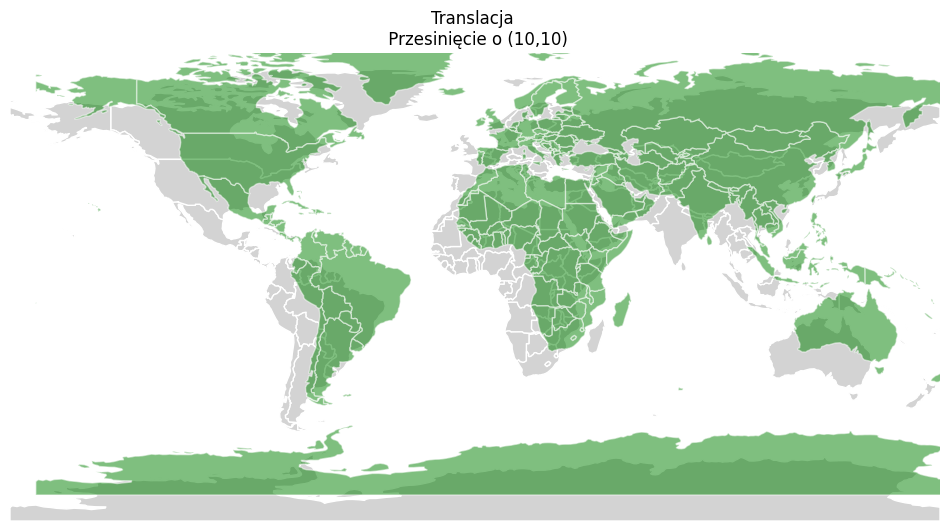

In [111]:
# Operacja affiniczna - translacja
translated_countries = countries.translate(xoff=10, yoff=10)

# Tworzenie wizualizacji
fig, ax = plt.subplots(figsize=(12, 8))

# Wizualizacja oryginalnych krajów
countries.plot(ax=ax, color='lightgray', edgecolor='white')

# Wizualizacja przesuniętych krajów
translated_countries.plot(ax=ax, color='green', edgecolor='white', alpha=0.5)

# Ustawienie ograniczeń osi
ax.set_xlim([-180, 180])
ax.set_ylim([-90, 90])


# Tytuł
plt.title('Translacja \n Przesinięcie o (10,10)')

# Usunięcie osi
ax.axis('off')

# Wyświetlenie wizualizacji
plt.show()

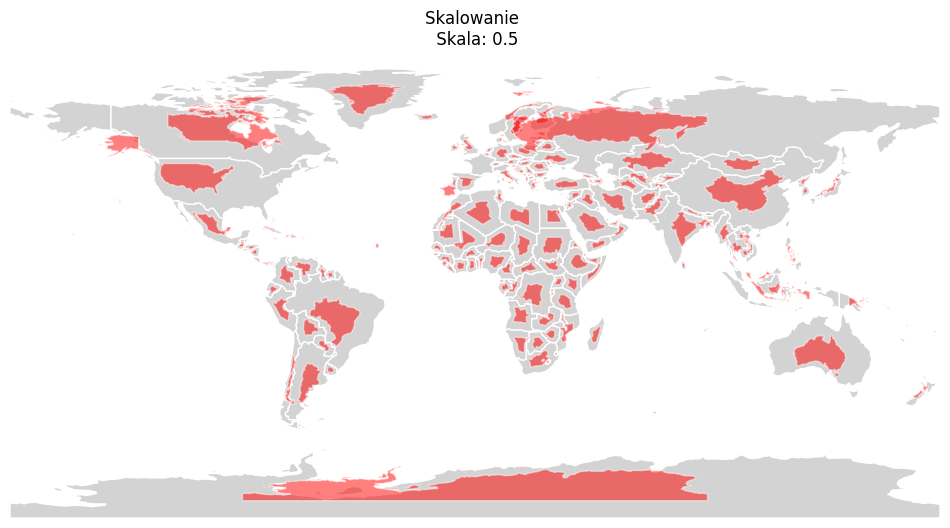

In [112]:
# Operacja affiniczna - skalowanie
scaled_countries = countries.scale(xfact=0.5, yfact=0.5)

# Tworzenie wizualizacji
fig, ax = plt.subplots(figsize=(12, 8))

# Wizualizacja oryginalnych krajów
countries.plot(ax=ax, color='lightgray', edgecolor='white')

# Wizualizacja przeskalowanych krajów
scaled_countries.plot(ax=ax, color='red', edgecolor='white', alpha=0.5)

# Ustawienie ograniczeń osi
ax.set_xlim([-180, 180])
ax.set_ylim([-90, 90])

# Usunięcie osi
ax.axis('off')

# Tytuł
plt.title(f"Skalowanie \n Skala: 0.5")

# Wyświetlenie wizualizacji
plt.show()

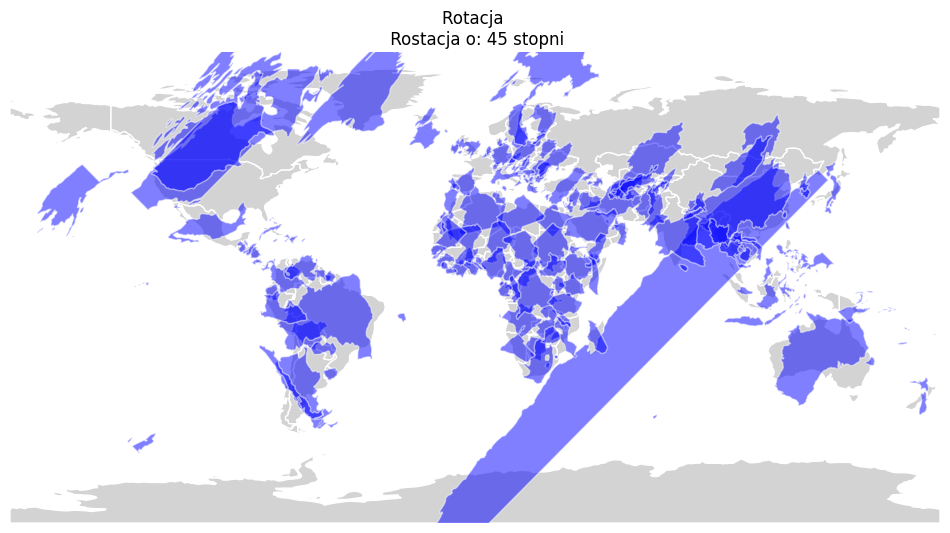

In [113]:
# Operacja affiniczna - rotacja
rotated_countries = countries.rotate(angle=45)

# Tworzenie wizualizacji
fig, ax = plt.subplots(figsize=(12, 8))

# Wizualizacja oryginalnych krajów
countries.plot(ax=ax, color='lightgray', edgecolor='white')

# Wizualizacja obróconych krajów
rotated_countries.plot(ax=ax, color='blue', edgecolor='white', alpha=0.5)


# Ustawienie ograniczeń osi
ax.set_xlim([-180, 180])
ax.set_ylim([-90, 90])


# Usunięcie osi
ax.axis('off')

# Tytuł
plt.title("Rotacja \n Rostacja o: 45 stopni")

# Wyświetlenie wizualizacji
plt.show()

# 7. Metody transformacji typów

Metody transformacji typów pozwalają na przekształcanie obiektów przestrzennych pomiędzy różnymi typami reprezentacji, np. pomiędzy formatami WKT i GeoJSON. W Pythonie można użyć funkcji to_wkt() i to_json() z biblioteki GeoPandas.

**Eksperyment 1 - różnice między formatem WTK, a GeoJSON**

In [114]:
# Tworzenie przykładowego punktu trójwymiarowego
point_3d = Point(1.6560, 2.50, 10.123456712345171)

# Tworzenie GeoDataFrame z pojedynczym punktem trójwymiarowym
gdf_point_3d = geopandas.GeoDataFrame(geometry=[point_3d])

# Konwersja do formatu WKT
wkt_representation = gdf_point_3d.geometry.to_wkt()

# Konwersja do formatu GeoJSON
geojson_representation = gdf_point_3d.geometry.to_json()

# Transformacja z formatu WKT do GeoJSON
gdf_wkt_to_geojson = geopandas.GeoDataFrame(geometry=geopandas.GeoSeries.from_wkt(wkt_representation))

# Transformacja z formatu GeoJSON do WKT
gdf_geojson_to_wkt = geopandas.GeoDataFrame.from_file(geojson_representation)

# Różnice między formatami WKT i GeoJSON
print("Różnice między formatami WKT i GeoJSON:")
print("---------------------------------------")

# Różnica 1: Sposób prezentacji i prezycji zapisu liczbowego danych 
print("Różnica 1: Prezentacja danych")
print("Oryginalny punkt (3D):")
print(gdf_point_3d)  
print()

print("Prezentacja i precyzja zapisu liczbowego danych w formacie WKT:")
print(wkt_representation)
print()

print("Prezentacja i precyzja zapisu liczbowego danych w formacie GeoJSON:")
print(geojson_representation)
print()


# Różnica 2: Konwersja formatów
print("Różnica 2: Konwersja formatów")
print("Konwersja formatu WKT do GeoJSON:")
print(gdf_wkt_to_geojson)
print()


print("Konwersja formatu GeoJSON do WTK:")
print(gdf_wkt_to_geojson)
print()







Różnice między formatami WKT i GeoJSON:
---------------------------------------
Różnica 1: Prezentacja danych
Oryginalny punkt (3D):
                             geometry
0  POINT Z (1.65600 2.50000 10.12346)

Prezentacja i precyzja zapisu liczbowego danych w formacie WKT:
0    POINT Z (1.656 2.5 10.123457)
dtype: object

Prezentacja i precyzja zapisu liczbowego danych w formacie GeoJSON:
{"type": "FeatureCollection", "features": [{"id": "0", "type": "Feature", "properties": {}, "geometry": {"type": "Point", "coordinates": [1.656, 2.5, 10.12345671234517]}, "bbox": [1.656, 2.5, 1.656, 2.5]}], "bbox": [1.656, 2.5, 1.656, 2.5]}

Różnica 2: Konwersja formatów
Konwersja formatu WKT do GeoJSON:
                             geometry
0  POINT Z (1.65600 2.50000 10.12346)

Konwersja formatu GeoJSON do WTK:
                             geometry
0  POINT Z (1.65600 2.50000 10.12346)



# 8. Sąsiedztwo, odległość i przecinanie obiektów

## Sąsiedztwo

**Eksperyment 1 - podróż do stolicy państw sąsiednich**

In [115]:
countries.head()

,iso_a3,name,continent,pop_est,gdp_md_est,geometry
0,AFG,Afghanistan,Asia,34124811.0,64080.0,"POLYGON ((61.21082 35.65007, 62.23065 35.27066..."
1,AGO,Angola,Africa,29310273.0,189000.0,"MULTIPOLYGON (((23.90415 -11.72228, 24.07991 -..."
2,ALB,Albania,Europe,3047987.0,33900.0,"POLYGON ((21.02004 40.84273, 20.99999 40.58000..."
3,ARE,United Arab Emirates,Asia,6072475.0,667200.0,"POLYGON ((51.57952 24.24550, 51.75744 24.29407..."
4,ARG,Argentina,South America,44293293.0,879400.0,"MULTIPOLYGON (((-66.95992 -54.89681, -67.56244..."


In [116]:
# wybór danego kraju (Polska)
target_country = countries[countries['name'] == 'Poland']

Text(0.5, 1.0, 'Polska')

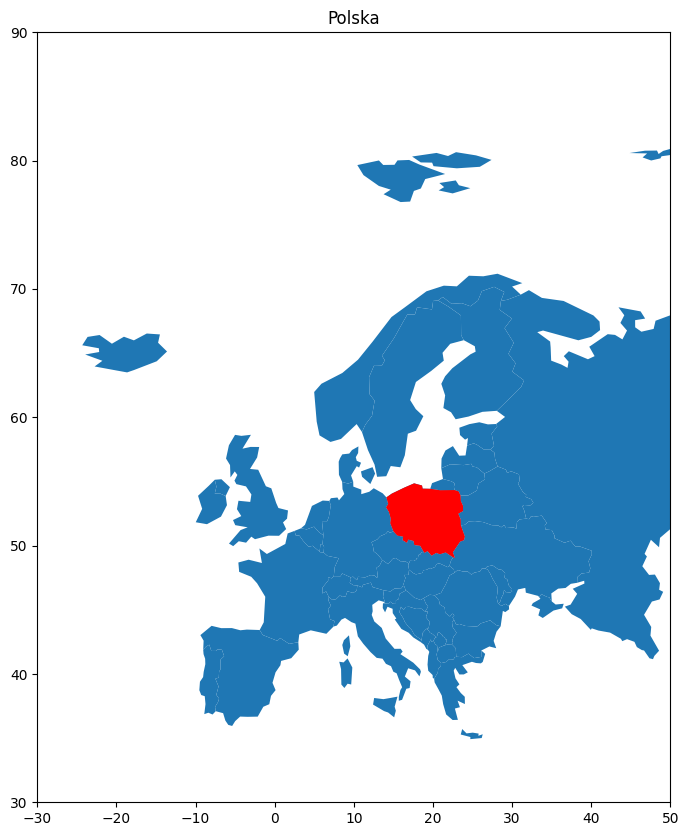

In [117]:
ax = countries[countries['continent'] ==  'Europe'].plot(figsize=(20,10))
target_country.plot(ax=ax, color='red')
ax.set(xlim=(-30, 50), ylim=(30, 90))
plt.title("Polska")

In [118]:
# Sprawdzenie sąsiadów danego państwa
neighbors = geopandas.sjoin(countries, target_country, how='inner', predicate='intersects')

# Wydrukowanie wyniku
neighbors

,iso_a3_left,name_left,continent_left,pop_est_left,gdp_md_est_left,geometry,index_right,iso_a3_right,name_right,continent_right,pop_est_right,gdp_md_est_right
19,BLR,Belarus,Europe,9549747.0,165400.0,"POLYGON ((23.48413 53.91250, 24.45068 53.90570...",127,POL,Poland,Europe,38476269.0,1052000.0
40,CZE,Czechia,Europe,10674723.0,350900.0,"POLYGON ((16.96029 48.59698, 16.49928 48.78581...",127,POL,Poland,Europe,38476269.0,1052000.0
41,DEU,Germany,Europe,80594017.0,3979000.0,"POLYGON ((13.59595 48.87717, 13.24336 48.41611...",127,POL,Poland,Europe,38476269.0,1052000.0
96,LTU,Lithuania,Europe,2823859.0,85620.0,"POLYGON ((26.49433 55.61511, 26.58828 55.16718...",127,POL,Poland,Europe,38476269.0,1052000.0
127,POL,Poland,Europe,38476269.0,1052000.0,"POLYGON ((23.48413 53.91250, 23.52754 53.47012...",127,POL,Poland,Europe,38476269.0,1052000.0
135,RUS,Russia,Europe,142257519.0,3745000.0,"MULTIPOLYGON (((48.58435 41.80887, 47.98728 41...",127,POL,Poland,Europe,38476269.0,1052000.0
149,SVK,Slovakia,Europe,5445829.0,168800.0,"POLYGON ((16.97967 48.12350, 16.87998 48.47001...",127,POL,Poland,Europe,38476269.0,1052000.0
166,UKR,Ukraine,Europe,44033874.0,352600.0,"POLYGON ((23.52707 51.57845, 24.00508 51.61744...",127,POL,Poland,Europe,38476269.0,1052000.0


Inna metoda wyznaczania sąsiadów

In [119]:
def find_neighbors(df):
    # Tworzenie pustej kolumny 'neighbors'
    df['neighbors'] = ''

    # Iteracja po każdym wierszu w GeoDataFrame
    for index, row in df.iterrows():
        # Wybieranie docelowego kraju
        target_country = df.iloc[index]

        # Sprawdzanie sąsiadów danego kraju
        neighbors = df[~df.geometry.disjoint(target_country.geometry)]

        # Tworzenie listy sąsiadów
        neighbors_list = neighbors['name'].tolist()

        # Aktualizacja kolumny 'neighbors' dla danego kraju
        df.at[index, 'neighbors'] = neighbors_list

    return df

In [120]:
# Wywołanie metody find_neighbors
world_with_neighbors = find_neighbors(countries)

# Wydrukowanie wyniku
world_with_neighbors[['name', 'neighbors']]

,name,neighbors
0,Afghanistan,"[Afghanistan, China, Iran, Pakistan, Tajikista..."
1,Angola,"[Angola, Dem. Rep. Congo, Congo, Namibia, Zambia]"
2,Albania,"[Albania, Greece, Kosovo, Macedonia, Montenegro]"
3,United Arab Emirates,"[United Arab Emirates, Oman, Saudi Arabia]"
4,Argentina,"[Argentina, Bolivia, Brazil, Chile, Paraguay, ..."
...,...,...
172,Vanuatu,[Vanuatu]
173,Yemen,"[Oman, Saudi Arabia, Yemen]"
174,South Africa,"[Botswana, Lesotho, Mozambique, Namibia, Swazi..."
175,Zambia,"[Angola, Botswana, Dem. Rep. Congo, Mozambique..."


In [121]:
world_with_neighbors.head()

,iso_a3,name,continent,pop_est,gdp_md_est,geometry,neighbors
0,AFG,Afghanistan,Asia,34124811.0,64080.0,"POLYGON ((61.21082 35.65007, 62.23065 35.27066...","[Afghanistan, China, Iran, Pakistan, Tajikista..."
1,AGO,Angola,Africa,29310273.0,189000.0,"MULTIPOLYGON (((23.90415 -11.72228, 24.07991 -...","[Angola, Dem. Rep. Congo, Congo, Namibia, Zambia]"
2,ALB,Albania,Europe,3047987.0,33900.0,"POLYGON ((21.02004 40.84273, 20.99999 40.58000...","[Albania, Greece, Kosovo, Macedonia, Montenegro]"
3,ARE,United Arab Emirates,Asia,6072475.0,667200.0,"POLYGON ((51.57952 24.24550, 51.75744 24.29407...","[United Arab Emirates, Oman, Saudi Arabia]"
4,ARG,Argentina,South America,44293293.0,879400.0,"MULTIPOLYGON (((-66.95992 -54.89681, -67.56244...","[Argentina, Bolivia, Brazil, Chile, Paraguay, ..."


In [122]:
poland = world_with_neighbors[world_with_neighbors['name'] == 'Poland']
poland

,iso_a3,name,continent,pop_est,gdp_md_est,geometry,neighbors
127,POL,Poland,Europe,38476269.0,1052000.0,"POLYGON ((23.48413 53.91250, 23.52754 53.47012...","[Belarus, Czechia, Germany, Lithuania, Poland,..."


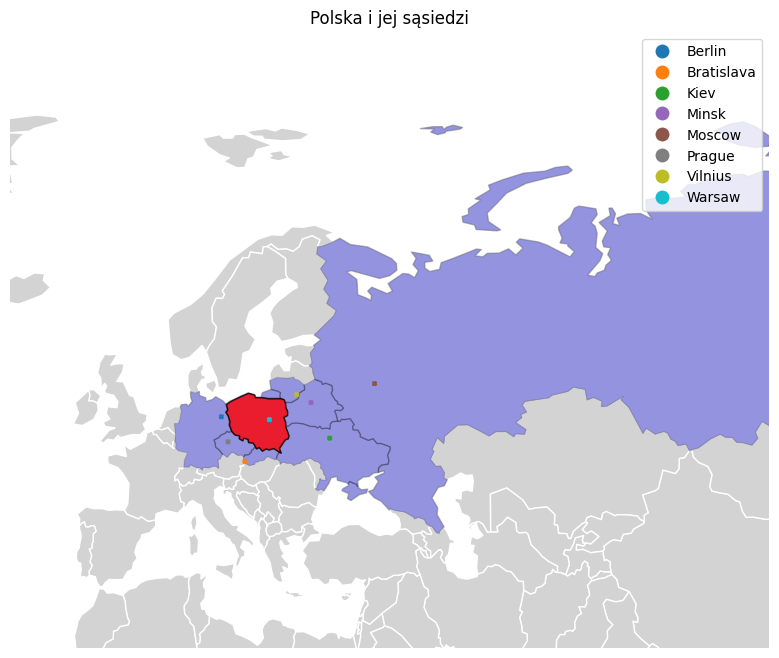

In [123]:
# Reset indeksów
countries = countries.reset_index(drop=True)
target_country = target_country.reset_index(drop=True)

# Wybór kraju i jego sąsiadów
neighbors = countries[countries.intersects(target_country.unary_union)]
cities = geopandas.read_file("ne_110m_populated_places.zip")

# Resetowanie indeksów dla cities
cities = cities.reset_index(drop=True)

# Tworzenie wizualizacji
fig, ax = plt.subplots(figsize=(12, 8))

# Wizualizacja świata
countries.plot(ax=ax, color='lightgray', edgecolor='white')

# Wizualizacja sąsiadów Polski
neighbors.plot(ax=ax, color='blue', edgecolor='black', alpha=0.3)

# Wizualizacja Polski
target_country.plot(ax=ax, color='red', edgecolor='black', alpha=0.8)

# Znalezienie stolicy Polski
capital_city = cities[cities.within(target_country.unary_union)]
capital = capital_city[capital_city.within(target_country.unary_union)]

neighbors_cities = cities[cities.within(neighbors.unary_union)]
neighbors_capital = neighbors_cities[neighbors_cities.within(neighbors.unary_union)]

# Wizualizacja stolicy Polski
capital.plot(ax=ax, marker='X', column='name', markersize=5, legend=True)
neighbors_capital.plot(ax=ax, marker='X', column='name', markersize=8, legend=True)

# Ustawienie ograniczeń osi
ax.set_xlim([-20, 100])
ax.set_ylim([30, 90])

# Usunięcie osi
ax.axis('off')

plt.title("Polska i jej sąsiedzi")

# Wyświetlenie wizualizacji
plt.show()


## Odległość

**Eksperyment 1 - odległość od stolic krajów sąsiadujących**

In [124]:
# Pobranie współrzędnych stolicy Polski (Warszawa)
warsaw_coords = (capital.iloc[0]['geometry'].y, capital.iloc[0]['geometry'].x)

# Obliczanie dystansu dla każdej stolicy w neighbors_capital
distances = []
for i in range(len(neighbors_capital)):
    city_coords = (neighbors_capital.iloc[i]['geometry'].y, neighbors_capital.iloc[i]['geometry'].x)
    city_name = neighbors_capital.iloc[i]['name']
    if city_coords != warsaw_coords:
        city_distance = distance(warsaw_coords, city_coords).kilometers
        distances.append((city_name, city_distance))

# Sortowanie dystansów
distances.sort(key=lambda x: x[1])

# Wyświetlanie wyników
for city, dist in distances:
    print(f"Dystans między {city} a Warszawą: {dist} kilometrów")

# Najbliższa destynacja
nearest_city = distances[0][0]
nearest_distance = distances[0][1]
print()
print(f"Najbliższa destynacja to {nearest_city} ({nearest_distance} km)")

# Najdalsza destynacja
farthest_city = distances[-1][0]
farthest_distance = distances[-1][1]
print(f"Najdalsza destynacja to {farthest_city} ({farthest_distance} km)")


Dystans między Vilnius a Warszawą: 394.174221638932 kilometrów
Dystans między Minsk a Warszawą: 476.62179108544797 kilometrów
Dystans między Prague a Warszawą: 516.4121920896865 kilometrów
Dystans między Berlin a Warszawą: 517.967447337985 kilometrów
Dystans między Bratislava a Warszawą: 533.6392318173173 kilometrów
Dystans między Kiev a Warszawą: 692.6191653981521 kilometrów
Dystans między Moscow a Warszawą: 1153.7043173100435 kilometrów

Najbliższa destynacja to Vilnius (394.174221638932 km)
Najdalsza destynacja to Moscow (1153.7043173100435 km)


**Eksperyment 1 - odległość między wieżą Eiffla, a centroidami dzielnic Paryża**

In [140]:
# Dzielnice Paryża
districts = geopandas.read_file("paris_districts.geojson").to_crs(epsg=2154)

# Stacje rowerowe w Paryżu
stations = geopandas.read_file("paris_bike_stations.gpkg").to_crs(epsg=2154)

In [141]:
eiffel_tower = Point(648237.3 , 6862271.9)
 
print(eiffel_tower)

POINT (648237.3 6862271.9)


In [142]:
# Środki gemoetryczne dzielnic Paryża
centroids = districts.centroid

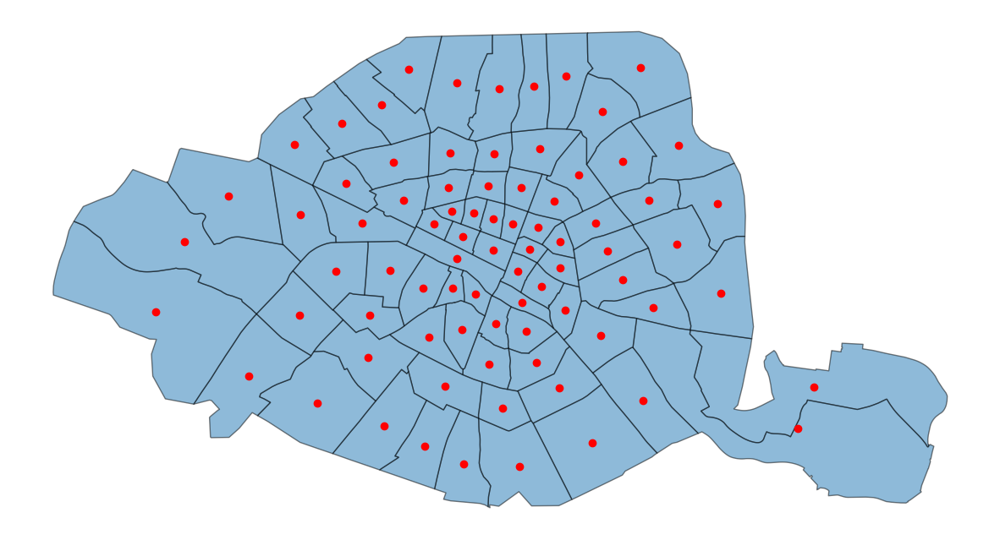

In [143]:
# Prezentacja położenia centroidów na wykresie dzielnic Paryża
ax = districts.plot(figsize=(15, 10), alpha=0.5, edgecolor='k')
centroids.plot(ax=ax, color='red')
ax.set_axis_off()

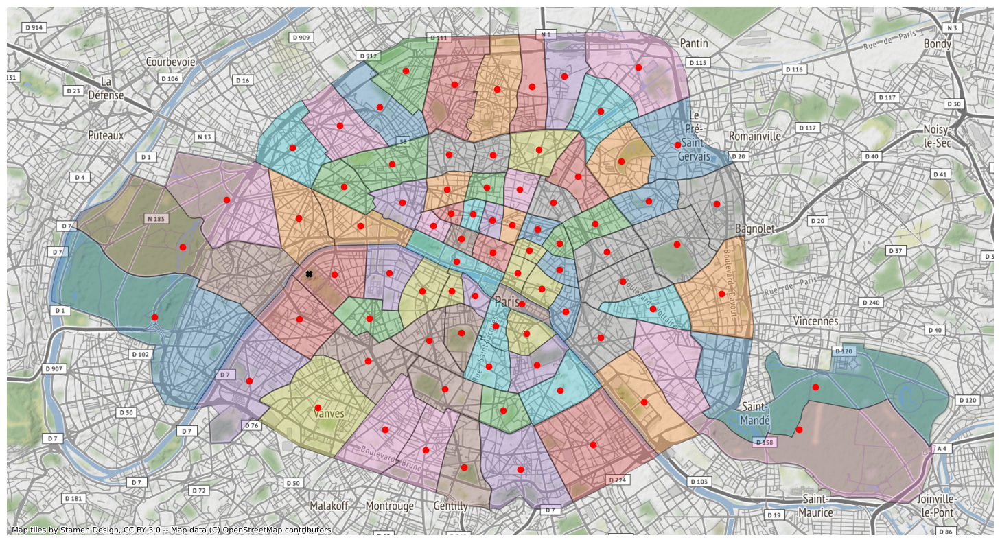

In [144]:
fig, ax = plt.subplots(figsize=(20, 10))
districts.to_crs(epsg=3857).plot(ax=ax, edgecolor='k', alpha=0.3, column='district_name')
geopandas.GeoSeries([eiffel_tower], crs='EPSG:2154').to_crs(epsg=3857).plot(ax=ax, color="black", marker="X")
centroids.to_crs(epsg=3857).plot(ax=ax, color='red')
contextily.add_basemap(ax)
ax.set_axis_off()

In [145]:
# Odległość środek geometrycznych dzielnic Paryża od wiezy Eiffla
districts['centroid'] = centroids
districts.head()

,id,district_name,population,geometry,centroid
0,1,St-Germain-l'Auxerrois,1672,"POLYGON ((651908.563 6861756.318, 651908.510 6...",POINT (651204.300 6862496.156)
1,2,Halles,8984,"POLYGON ((652264.717 6862479.030, 652178.752 6...",POINT (651938.581 6862672.260)
2,3,Palais-Royal,3195,"POLYGON ((651539.853 6862658.479, 651514.121 6...",POINT (651310.610 6862941.143)
3,4,Place-Vendôme,3044,"POLYGON ((650990.707 6862971.961, 650946.460 6...",POINT (650745.971 6863208.195)
4,5,Gaillon,1345,"POLYGON ((651314.531 6863309.339, 651280.525 6...",POINT (651103.905 6863459.594)


In [146]:
districts.head()

,id,district_name,population,geometry,centroid
0,1,St-Germain-l'Auxerrois,1672,"POLYGON ((651908.563 6861756.318, 651908.510 6...",POINT (651204.300 6862496.156)
1,2,Halles,8984,"POLYGON ((652264.717 6862479.030, 652178.752 6...",POINT (651938.581 6862672.260)
2,3,Palais-Royal,3195,"POLYGON ((651539.853 6862658.479, 651514.121 6...",POINT (651310.610 6862941.143)
3,4,Place-Vendôme,3044,"POLYGON ((650990.707 6862971.961, 650946.460 6...",POINT (650745.971 6863208.195)
4,5,Gaillon,1345,"POLYGON ((651314.531 6863309.339, 651280.525 6...",POINT (651103.905 6863459.594)


In [147]:
dist_eiffel_centroid = districts['centroid'].distance(eiffel_tower)
dist_eiffel_centroid #districts CRS:2154 -> odległosci w metrach

0     2975.462877
1     3722.870716
2     3145.332773
3     2677.699845
4     3102.908555
         ...     
75    6672.271378
76    6980.639094
77    8312.044673
78    7417.060226
79    8296.011148
Length: 80, dtype: float64

In [148]:
districts['dist_to_eiffel'] = dist_eiffel_centroid  
districts.head()

,id,district_name,population,geometry,centroid,dist_to_eiffel
0,1,St-Germain-l'Auxerrois,1672,"POLYGON ((651908.563 6861756.318, 651908.510 6...",POINT (651204.300 6862496.156),2975.462877
1,2,Halles,8984,"POLYGON ((652264.717 6862479.030, 652178.752 6...",POINT (651938.581 6862672.260),3722.870716
2,3,Palais-Royal,3195,"POLYGON ((651539.853 6862658.479, 651514.121 6...",POINT (651310.610 6862941.143),3145.332773
3,4,Place-Vendôme,3044,"POLYGON ((650990.707 6862971.961, 650946.460 6...",POINT (650745.971 6863208.195),2677.699845
4,5,Gaillon,1345,"POLYGON ((651314.531 6863309.339, 651280.525 6...",POINT (651103.905 6863459.594),3102.908555


In [149]:
dist_eiffel_centroid.nlargest().to_frame()

,0
44,10426.875680
45,10340.102105
77,8312.044673
79,8296.011148
74,7842.325093


In [150]:
dist_eiffel_centroid.nsmallest().to_frame()

,0
27,516.772572
58,935.561507
63,1134.484506
28,1417.033128
26,1507.032976


In [151]:
# Najmniejsza odległość
dist_eiffel_centroid.min()

516.7725719199299

In [152]:
districts[districts['dist_to_eiffel'] == dist_eiffel_centroid.min()]

,id,district_name,population,geometry,centroid,dist_to_eiffel
27,28,Gros-Caillou,25156,"POLYGON ((649336.752 6861767.761, 649110.815 6...",POINT (648753.827 6862255.955),516.772572


In [153]:
# Dzielnice Paryża, których środki geometryczne są w odległosci mniejszej niż 1,5 km od wiezy Eiffla
districts_eiffel = districts[dist_eiffel_centroid < 1500]

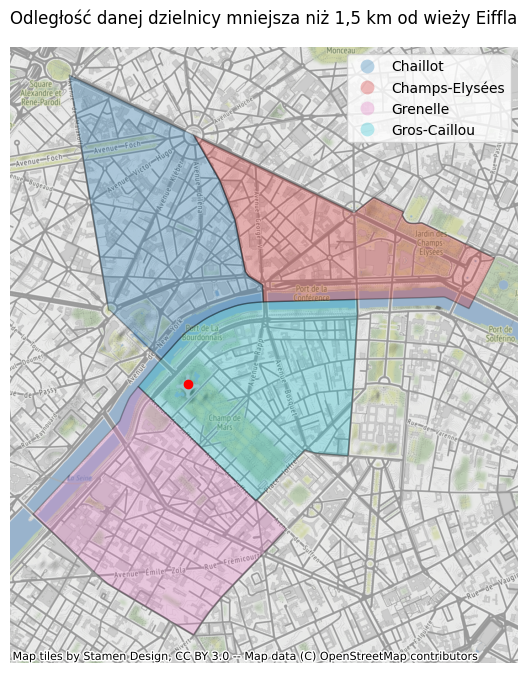

In [154]:
# Wizualizacja wyników
fig, ax = plt.subplots(figsize=(8, 8))
districts_eiffel.to_crs(epsg=3857).plot(ax=ax, edgecolor='k', alpha=0.3, column='district_name', legend=True)
geopandas.GeoSeries([eiffel_tower], crs='EPSG:2154').to_crs(epsg=3857).plot(ax=ax, color='red')
contextily.add_basemap(ax)
plt.title('Odległość danej dzielnicy mniejsza niż 1,5 km od wieży Eiffla')
ax.set_axis_off()

**Eksperyment 2 - najbliższe stacje rowerowe w sąsiedztwie wieży Eiffla**

In [155]:
# Odległość stacji rowerowych od wieży Eiffla
dist_eiffel_station = stations.distance(eiffel_tower)
dist_eiffel_station

0        3343.212509
1        8260.688451
2        8126.514622
3       10482.807156
4       10176.957110
            ...     
1221     6636.204309
1222     6153.437794
1223     2709.390547
1224     3633.146997
1225     2420.249246
Length: 1226, dtype: float64

In [156]:
stations['dist_to_eiffel'] = dist_eiffel_station  # w m
stations.head() 

,name,bike_stands,available_bikes,geometry,dist_to_eiffel
0,14002 - RASPAIL QUINET,44,4,POINT (650791.111 6860114.328),3343.212509
1,20503 - COURS DE VINCENNES PYRÉNÉES,21,3,POINT (656402.183 6861017.443),8260.688451
2,20011 - PYRÉNÉES-DAGORNO,21,0,POINT (656354.481 6861882.518),8126.514622
3,31008 - VINCENNES (MONTREUIL),56,0,POINT (658718.855 6862109.911),10482.807156
4,43006 - MINIMES (VINCENNES),28,27,POINT (658223.433 6860310.369),10176.957110


In [157]:
dist_eiffel_station.min()

232.34672323280478

In [158]:
stations[stations['dist_to_eiffel'] == dist_eiffel_station.min()]

,name,bike_stands,available_bikes,geometry,dist_to_eiffel
1154,07025 - SUFFREN TOUR EIFFEL,33,32,POINT (648138.476 6862061.617),232.346723


In [159]:
# Stacje rowerowe bliżej niż 1,5 km
stations_eiffel = stations[dist_eiffel_station < 1500]

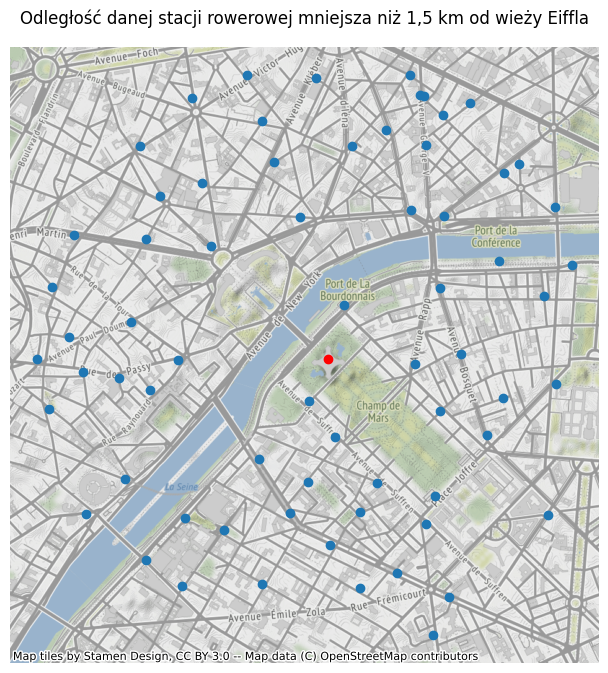

In [160]:
# Wizualizacja wyników
fig, ax = plt.subplots(figsize=(8, 8))
stations_eiffel.to_crs(epsg=3857).plot(ax=ax)
geopandas.GeoSeries([eiffel_tower], crs='EPSG:2154').to_crs(epsg=3857).plot(ax=ax, color='red')
contextily.add_basemap(ax)
plt.title('Odległość danej stacji rowerowej mniejsza niż 1,5 km od wieży Eiffla')
ax.set_axis_off()

In [161]:
# Inny sposób
m = stations_eiffel.explore(marker_kwds=dict(radius=5))
geopandas.GeoSeries([eiffel_tower], crs='EPSG:2154').explore(m=m, color='red', marker_kwds=dict(radius=5))

## Przecinanie

**Eksperyment 1 - przez jakie kraje przepływa Amazonka**

In [162]:
# Amaonka
amazon = rivers[rivers['name'] == 'Amazonas']

In [163]:
# Badanie przecięcia
cross_country = countries[countries.crosses(amazon.geometry.item())]
cross_country

,iso_a3,name,continent,pop_est,gdp_md_est,geometry,neighbors
22,BRA,Brazil,South America,207353391.0,3081000.0,"POLYGON ((-57.62513 -30.21629, -56.29090 -28.8...","[Argentina, Bolivia, Brazil, Colombia, France,..."
35,COL,Colombia,South America,47698524.0,688000.0,"POLYGON ((-66.87633 1.25336, -67.06505 1.13011...","[Brazil, Colombia, Ecuador, Panama, Peru, Vene..."
124,PER,Peru,South America,31036656.0,410400.0,"POLYGON ((-69.52968 -10.95173, -68.66508 -12.5...","[Bolivia, Brazil, Chile, Colombia, Ecuador, Peru]"


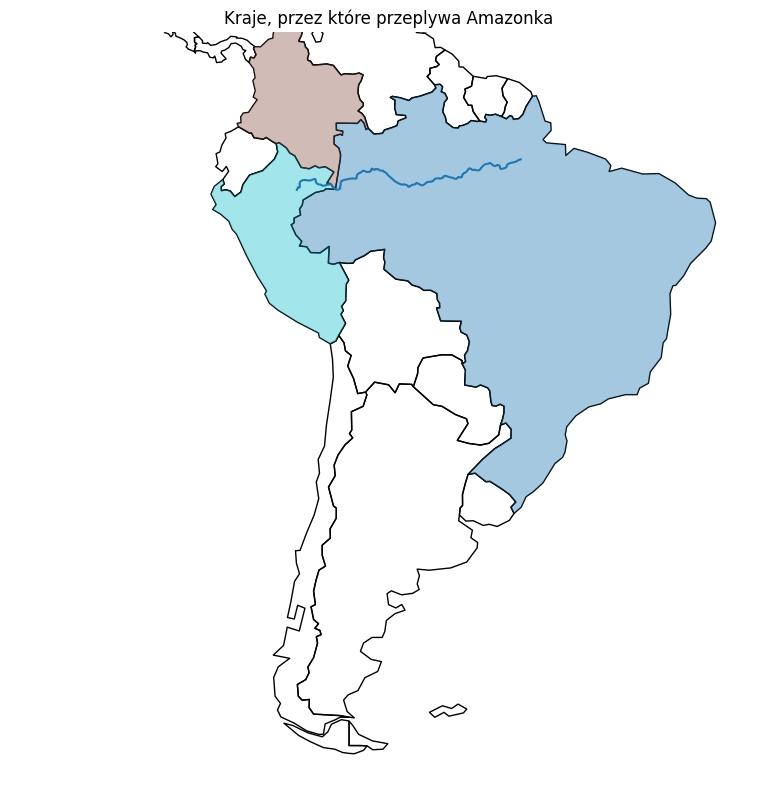

In [164]:
# Wizualizacja 
ax = countries.plot(edgecolor='k', facecolor='none', figsize=(15, 10))
amazon.plot(ax=ax)
cross_country.plot(ax=ax, column='name', alpha=0.4)
ax.set(xlim=(-100, -30), ylim=(-60, 10))
plt.title('Kraje, przez które przeplywa Amazonka')
plt.axis('off')
plt.show()